# Liveness-Tracking Results

Here are the results for the liveness tests.

## 1. Imports

Import the libraries to process the data

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
import seaborn as sns
from math import prod
import os

## 2. Read Data

Read in the data for each test result.

In [2]:
# The data is stored in a 5XX.csv for the serial tests, and 6XX.csv for the parallel tests
# The data files are in the `/data` folder

# Check if the data is loaded
# If not, load it
if 'all_data' in locals():
    print("Data already loaded")
else:
    # A structure for storing the data
    all_data = {}

    for i in range(500, 600):
        if os.path.isfile("../data/page-liveness-test/" + str(i) + ".csv"):
            all_data[i] = pd.read_csv("../data/page-liveness-test/" + str(i) + ".csv")
            print("Loaded data for test " + str(i))

Loaded data for test 500
Loaded data for test 502
Loaded data for test 505
Loaded data for test 508
Loaded data for test 511
Loaded data for test 519
Loaded data for test 523
Loaded data for test 525
Loaded data for test 526
Loaded data for test 531
Loaded data for test 538
Loaded data for test 541
Loaded data for test 544
Loaded data for test 549
Loaded data for test 557


In [3]:
class Page:
    def __init__(self, physical_address, site):
        self.physical_address = physical_address
        self.site = site
        self.data = []
    
    def __hash__(self):
        return hash(self.physical_address)

    def get_address(self):
        return self.physical_address

    def get_site(self):
        return self.site
    
    def get_age(self, interval):
        return interval - self.get_first_interval()

    def add_row(self, row):
        self.data.append(row)

    def get_data(self):
        return self.data
    
    def get_interval_of_last_write(self, interval = None):
        '''
        Get the interval number of the last write to this page

        If the page was never written to, this will return -1
        '''
        if interval is not None:
            for row in self.data[::-1]:
                if row["Interval #"] <= interval and row["Written During This Interval?"]:
                    return row["Interval #"]
            return -1

        for row in self.data[::-1]:
            if row["Written During This Interval?"]:
                return row["Interval #"]
        return -1
    
    def get_first_interval(self):
        '''
        Get the first interval this page was alive for
        '''
        return self.data[0]["Interval #"]
    
    def get_last_interval(self):
        return self.data[-1]["Interval #"]
    
    def get_data_after_last_write(self):
        '''
        Get the data after the last write to this page

        If the page was never written to, this will return the entire data
        '''
        result = []
        for row in self.data:
            if row["Written During This Interval?"]:
                result = []
            else:
                result.append(row)
        assert sum([1 for row in result if row["Written During This Interval?"]]) == 0
        last_write = self.get_interval_of_last_write()
        assert len(result) == 0 or result[0]["Interval #"] == last_write + 1 or last_write == -1
        return result

    def get_data_for_longest_lifetime_without_write(self):
        '''
        Get the data for the longest lifetime without a write to this page

        If this page was always written to, this will return an empty list
        '''

        longest_contiguous = 0
        current_contiguous = 0

        result = []
        for i, row in enumerate(self.data):
            if not row["Written During This Interval?"]:
                current_contiguous += 1
            else:
                if current_contiguous > longest_contiguous:
                    result = self.data[i-current_contiguous:i]
                    longest_contiguous = current_contiguous

                current_contiguous = 0

        if current_contiguous > longest_contiguous:
            result = self.data[-current_contiguous:]
            longest_contiguous = current_contiguous


        assert len(result) == self.get_longest_lifetime_without_write()
        assert len(result) == longest_contiguous
        assert sum([1 for row in result if row["Written During This Interval?"]]) == 0

        return result
    
    def was_written_to_during_interval(self, interval):
        '''
        Check if this page was written to during the given interval
        '''
        return any([row["Interval #"] == interval and row["Written During This Interval?"] for row in self.data])

    def get_average_compression_savings_in_bytes(self):
        '''
        Get the average amount of memory saved by compressing the physical pages in bytes
        '''
        return sum([row["Page Physical Page Compression Savings (bytes)"] for row in self.data]) / len(self.data)

    def __repr__(self):
        return "Page: " + str(self.physical_address)

# class Address:
#     def __init__(self, address, site):
#         self.address = address
#         self.site = site
#         self.associated_objects = []

#     def get_objects(self):
#         return self.associated_objects

#     def add_row(self, row):
#         if row["Is new?"]:
#             self.associated_objects.append(Object(self))
#         self.associated_objects[-1].add_row(row) 

#     def __str__(self):
#         result = "Address: " + str(self.address) + "\n"
#         for obj in self.associated_objects:
#             result += str(obj) + "\n"
#         return result

#     def __repr__(self):
#         return str(self)

## 3. Process Results

Go through the data and process some results.

## 3.1 New, Stale, and Hot Allocations

This graphs the number of live objects each iteration, the number of new objects allocated that iteration, and the objects that were written to that iteration. The ages of the objects are also denoted by the color, and the brightness indicates the compression savings.

Number of tests: 15
Test 500 done
Test 500
Tracked 3223 pages
Sampled 400 pages
Total pages for intervals: [6, 8, 9, 12, 16, 20, 23, 24, 28, 31, 30, 31, 32, 38, 38, 41, 44, 48, 50, 52, 54, 57, 61, 64, 67, 71, 76, 78, 80, 85, 87, 90, 93, 92, 99, 100, 93, 89, 98, 101, 103, 104, 107, 99, 111, 121, 135]
Total written for intervals: [6, 6, 2, 5, 9, 10, 9, 10, 13, 16, 10, 12, 11, 19, 9, 14, 17, 14, 15, 13, 13, 17, 18, 9, 17, 23, 21, 26, 11, 11, 19, 12, 18, 15, 17, 9, 6, 2, 7, 6, 6, 15, 11, 3, 8, 6, 13]
Total new for intervals: [6, 2, 1, 3, 4, 4, 3, 1, 4, 3, 7, 7, 25, 8, 1, 3, 3, 5, 2, 2, 2, 3, 4, 3, 3, 4, 5, 2, 2, 5, 3, 3, 3, 1, 7, 1, 42, 38, 30, 10, 2, 3, 4, 3, 33, 41, 49]
10.0% done
20.0% done
30.0% done
40.0% done
50.0% done
60.0% done
70.0% done
80.0% done
90.0% done
100.0% done
Done processing data for test 500
Graphing data...


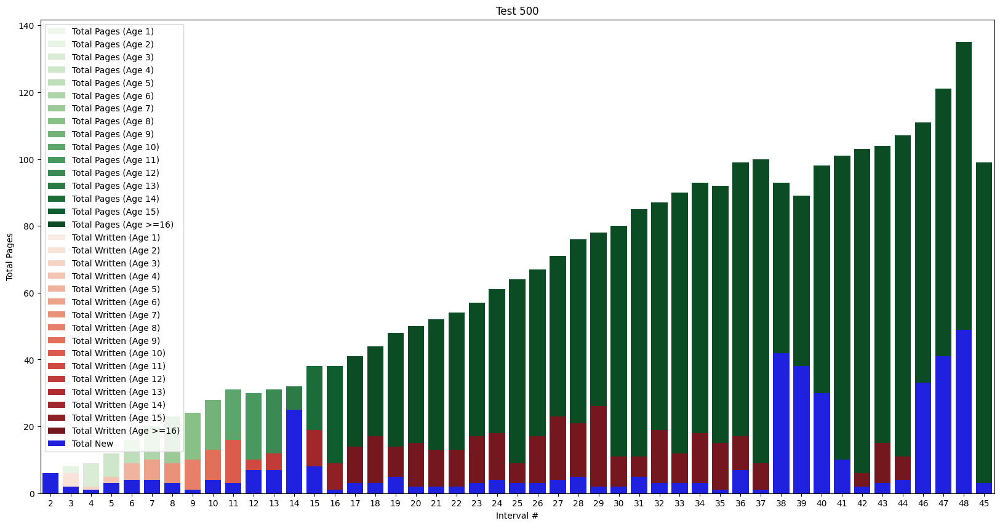

Done with first graph, moving on to the next...


<Figure size 2000x1000 with 0 Axes>

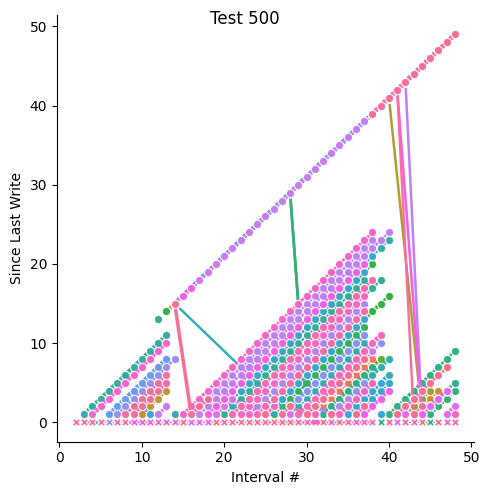

Done with second graph, moving on to the next...


<Figure size 2000x1000 with 0 Axes>

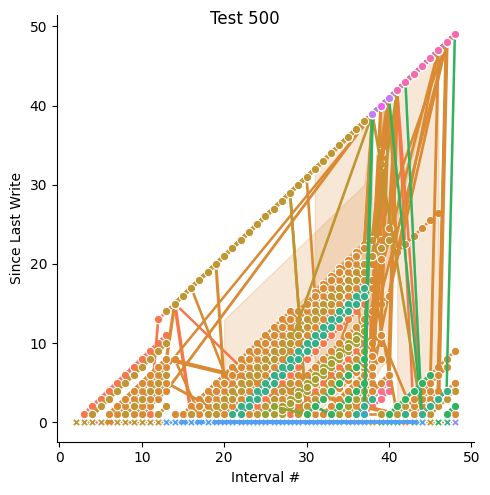

Done with third graph, moving on to the next...


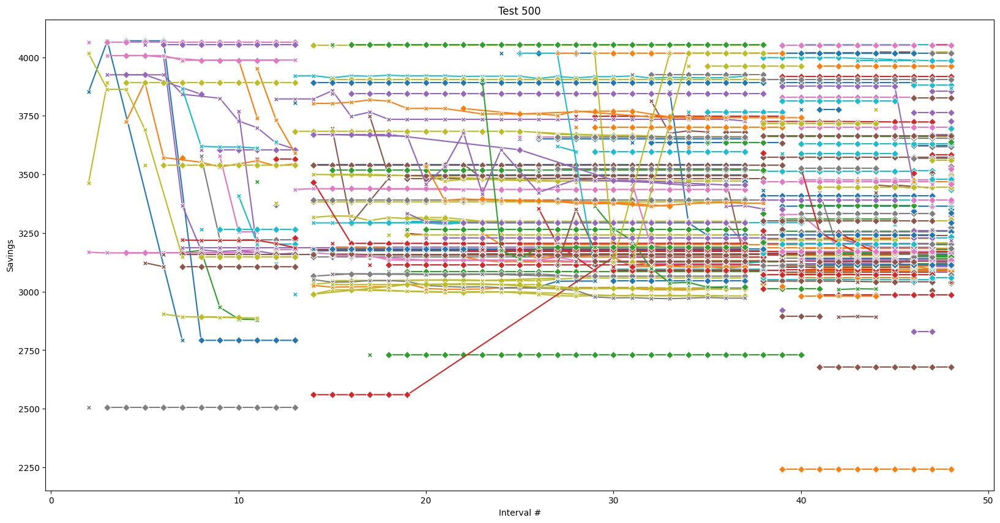

Done with fourth graph, moving on to the next...


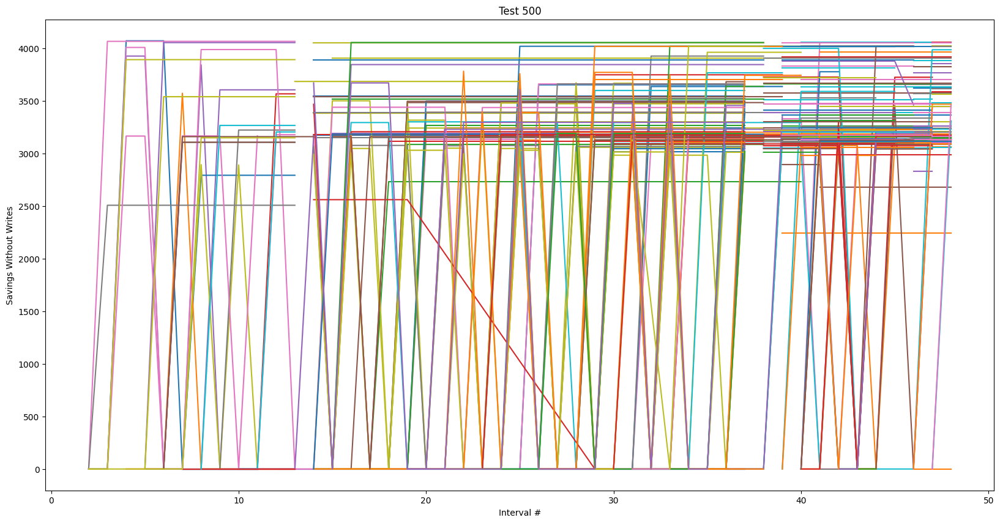

Done with fifth graph, moving on to the next...
Test 502 done
Test 502
Tracked 7231 pages
Sampled 400 pages
Total pages for intervals: [207, 226, 227, 229, 234, 235, 236, 236, 236, 238, 238, 239, 239, 241, 239, 240, 242, 242, 243, 243, 247, 249, 249, 250, 251, 252, 252, 254, 255, 256, 257, 259, 259, 259, 259, 259, 261, 263, 263, 265, 267, 270, 271, 272, 272, 273, 274, 274, 279, 280, 281, 283, 284, 287, 288, 288, 295, 295, 297, 299, 299, 301, 306, 310, 310]
Total written for intervals: [207, 165, 194, 164, 143, 77, 60, 84, 74, 177, 48, 62, 120, 119, 113, 120, 140, 96, 95, 61, 40, 42, 31, 32, 41, 41, 33, 53, 48, 48, 38, 46, 53, 59, 81, 67, 76, 89, 81, 78, 69, 73, 63, 59, 72, 77, 72, 94, 72, 81, 82, 84, 84, 87, 91, 82, 97, 83, 88, 74, 81, 95, 109, 118, 156]
Total new for intervals: [207, 25, 1, 2, 6, 1, 1, 0, 0, 2, 0, 1, 0, 2, 23, 1, 2, 0, 1, 0, 6, 2, 0, 1, 1, 1, 0, 2, 1, 1, 1, 2, 0, 0, 0, 0, 2, 2, 0, 2, 2, 3, 1, 1, 0, 1, 1, 0, 5, 1, 2, 2, 1, 3, 1, 1, 60, 0, 3, 2, 0, 2, 5, 4, 0]
10.0% don

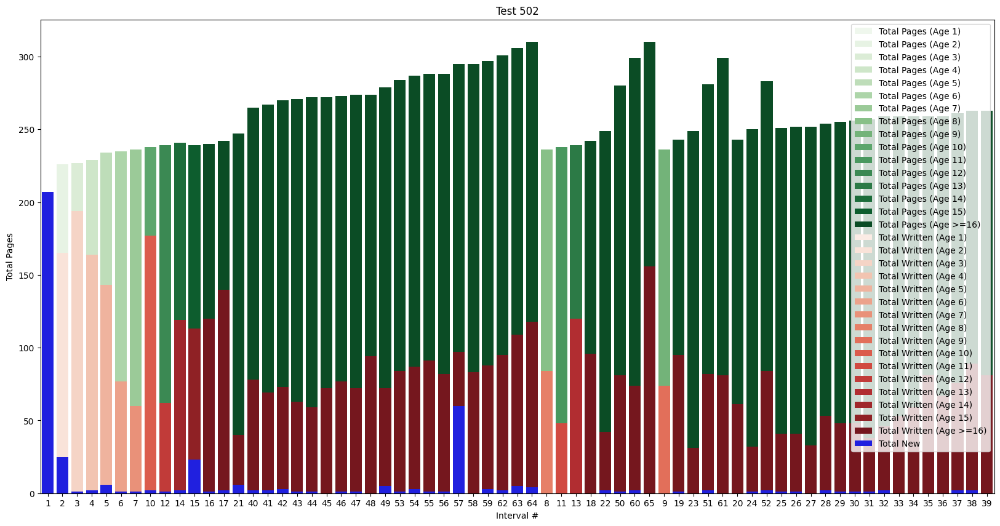

Done with first graph, moving on to the next...


<Figure size 2000x1000 with 0 Axes>

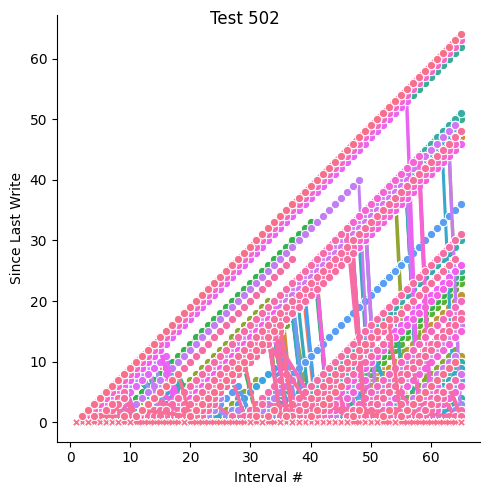

Done with second graph, moving on to the next...


<Figure size 2000x1000 with 0 Axes>

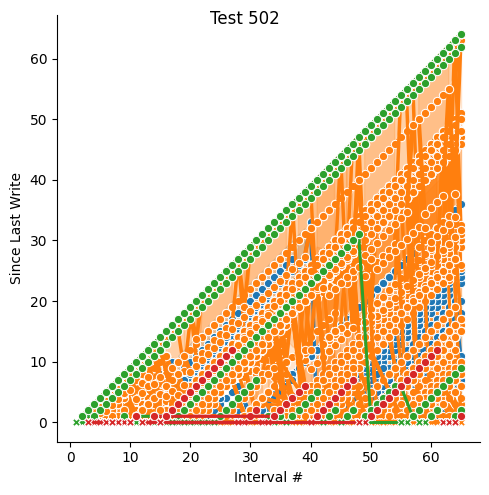

Done with third graph, moving on to the next...


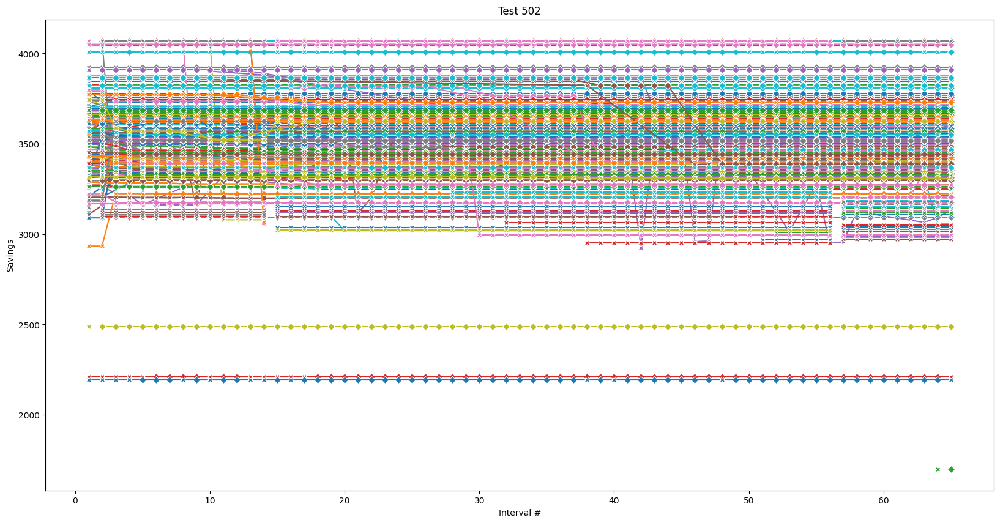

Done with fourth graph, moving on to the next...


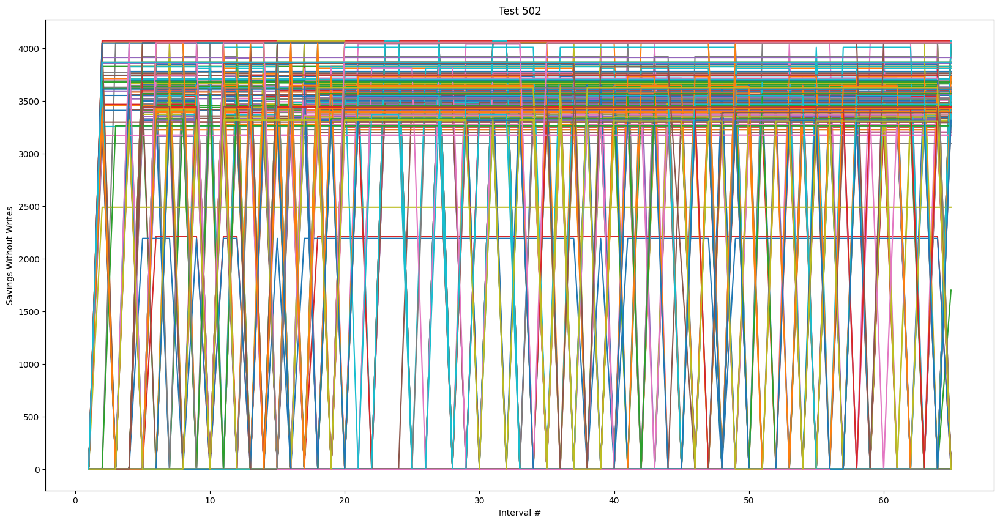

Done with fifth graph, moving on to the next...
Test 505 done
Test 505
Tracked 86238 pages
Sampled 400 pages
Total pages for intervals: [27, 139, 108, 107, 108, 107, 135, 138, 145, 151, 153, 107, 107, 133, 107, 108, 107, 145, 107, 107, 141, 142]
Total written for intervals: [27, 139, 103, 107, 108, 107, 135, 138, 145, 151, 153, 107, 107, 133, 107, 108, 107, 145, 107, 107, 141, 142]
Total new for intervals: [27, 129, 0, 0, 1, 0, 28, 25, 36, 21, 24, 0, 0, 26, 0, 1, 0, 38, 0, 0, 34, 10]
10.0% done
20.0% done
30.0% done
40.0% done
50.0% done
60.0% done
70.0% done
80.0% done
90.0% done
100.0% done
Done processing data for test 505
Graphing data...


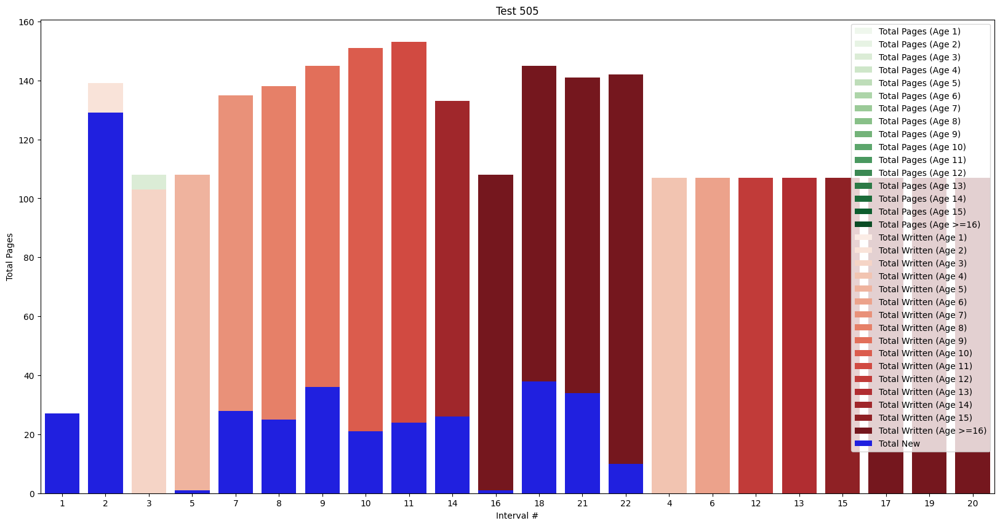

Done with first graph, moving on to the next...


<Figure size 2000x1000 with 0 Axes>

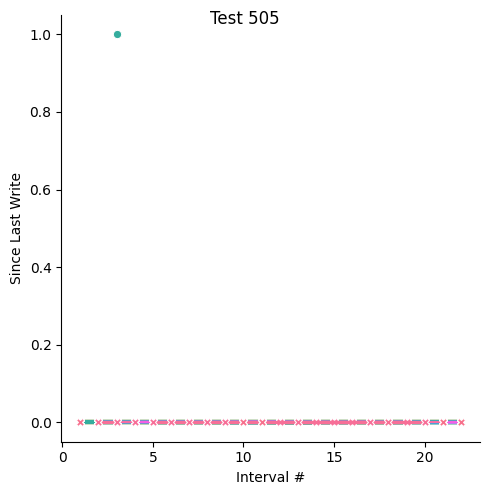

Done with second graph, moving on to the next...


<Figure size 2000x1000 with 0 Axes>

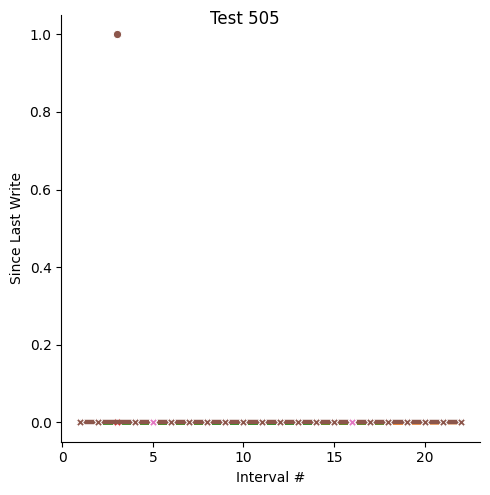

Done with third graph, moving on to the next...


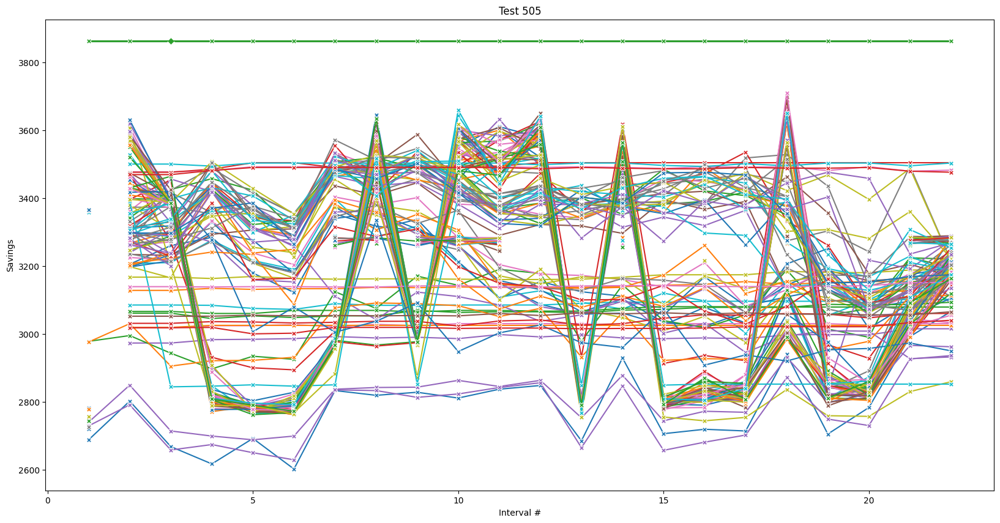

Done with fourth graph, moving on to the next...


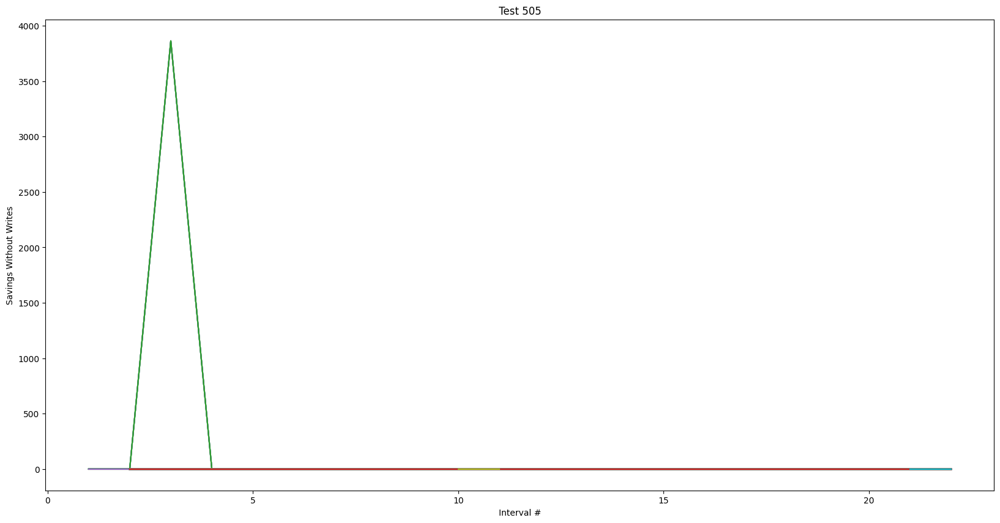

Done with fifth graph, moving on to the next...
Test 508 done
Test 508
Tracked 32020 pages
Sampled 400 pages
Total pages for intervals: [379, 387, 390, 390, 392, 393, 393, 393, 394, 395, 395, 396, 396, 47]
Total written for intervals: [379, 346, 345, 345, 347, 349, 349, 349, 350, 351, 351, 351, 350, 29]
Total new for intervals: [379, 8, 3, 2, 2, 1, 0, 0, 1, 1, 0, 1, 0, 2]
10.0% done
20.0% done
30.0% done
40.0% done
50.0% done
60.0% done
70.0% done
80.0% done
90.0% done
100.0% done
Done processing data for test 508
Graphing data...


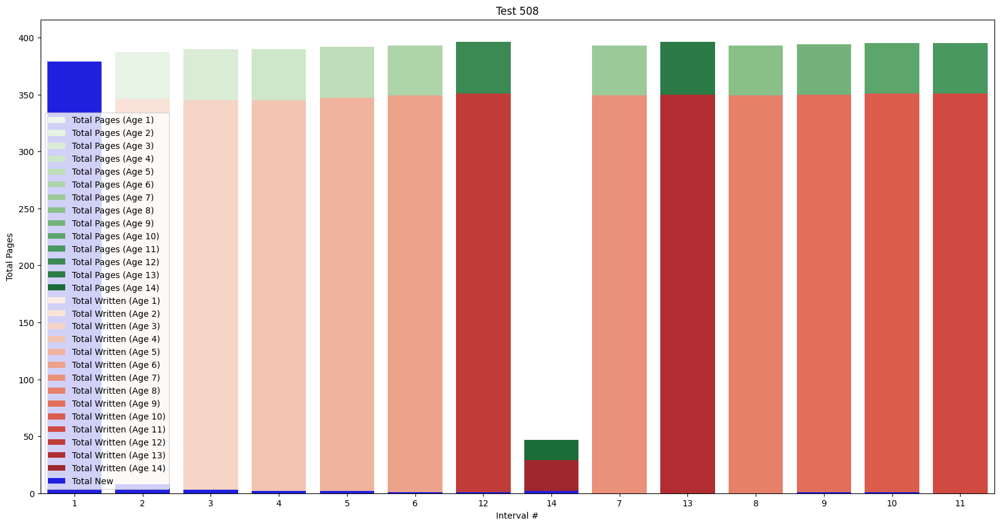

Done with first graph, moving on to the next...


<Figure size 2000x1000 with 0 Axes>

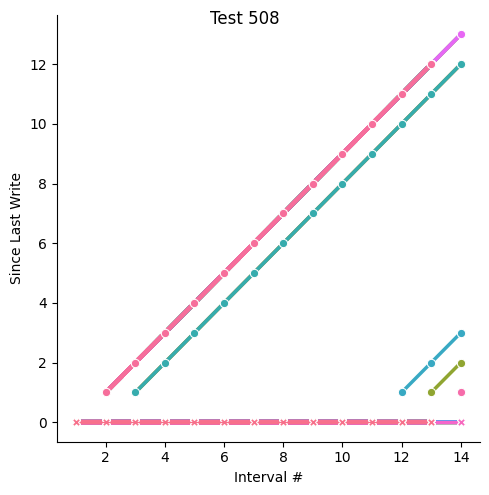

Done with second graph, moving on to the next...


<Figure size 2000x1000 with 0 Axes>

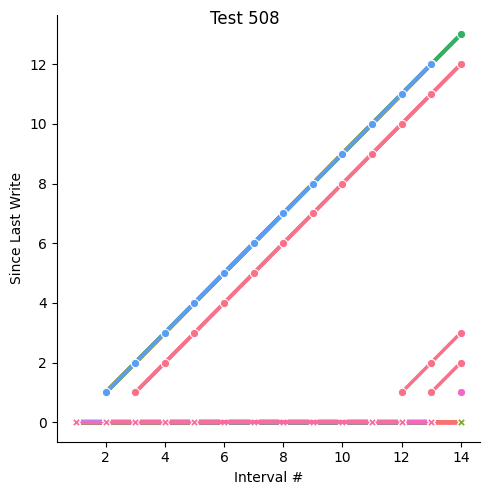

Done with third graph, moving on to the next...


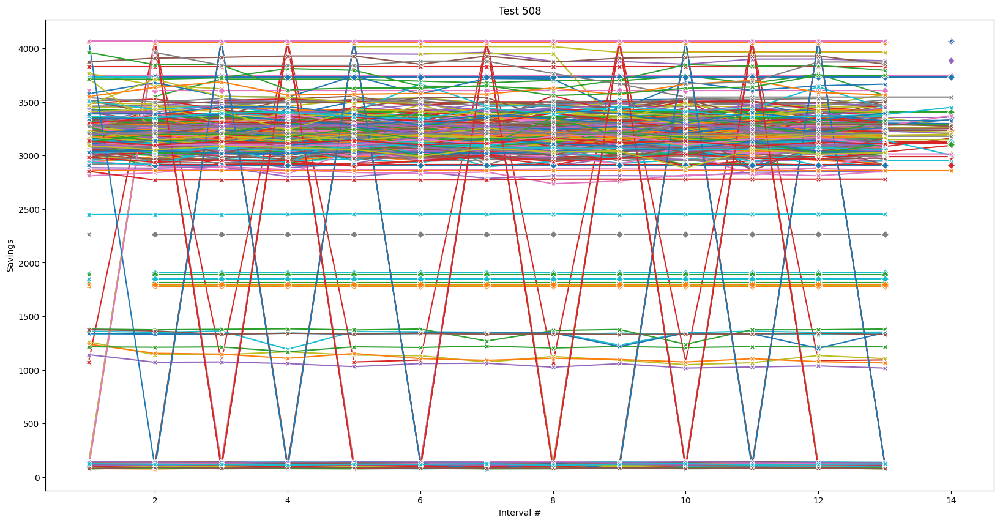

Done with fourth graph, moving on to the next...


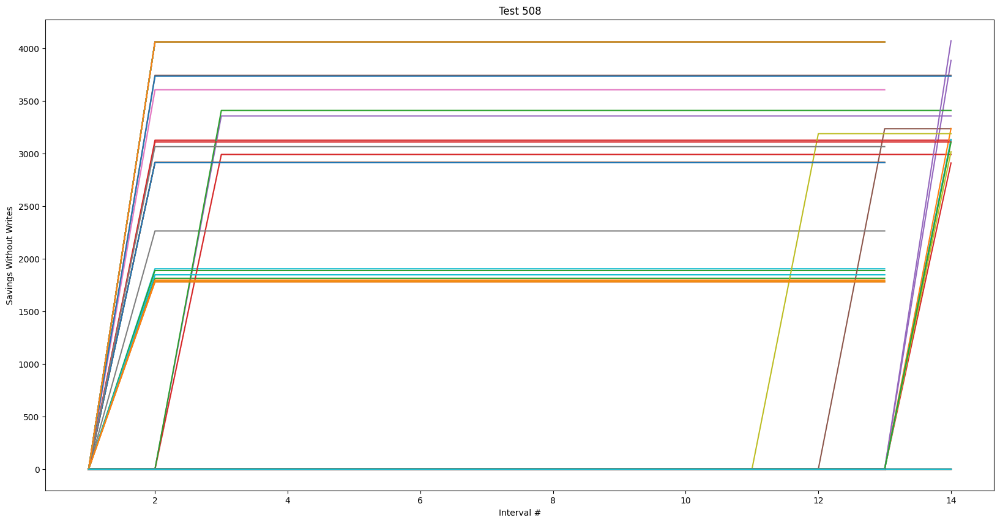

Done with fifth graph, moving on to the next...
Test 511 done
Test 511
Tracked 287 pages
Sampled 287 pages
Total pages for intervals: [284, 286, 286, 286, 286, 286, 286, 286, 286, 286, 286, 286, 286, 286, 286, 286, 286, 286, 286, 286, 286, 286, 286, 286, 286, 256]
Total written for intervals: [284, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 49, 92]
Total new for intervals: [284, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
100.0% done
Done processing data for test 511
Graphing data...


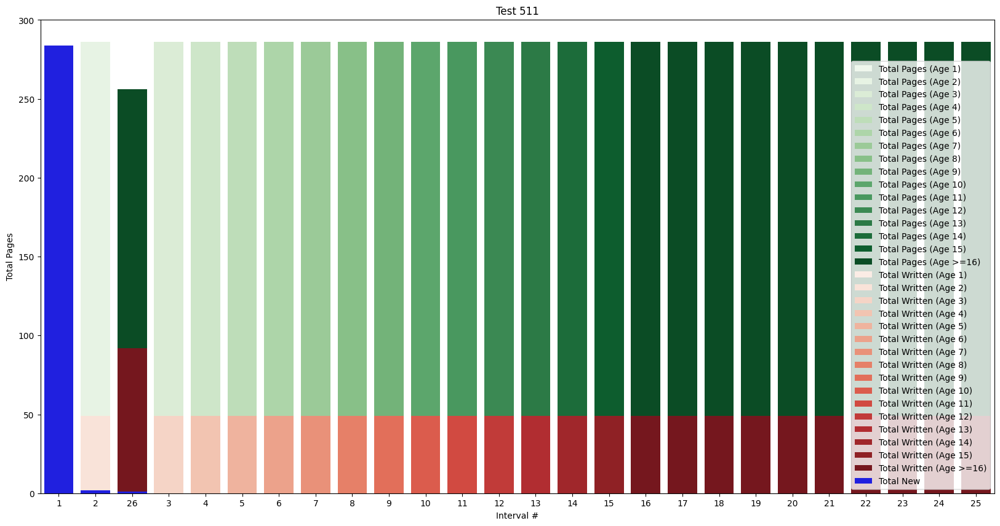

Done with first graph, moving on to the next...


<Figure size 2000x1000 with 0 Axes>

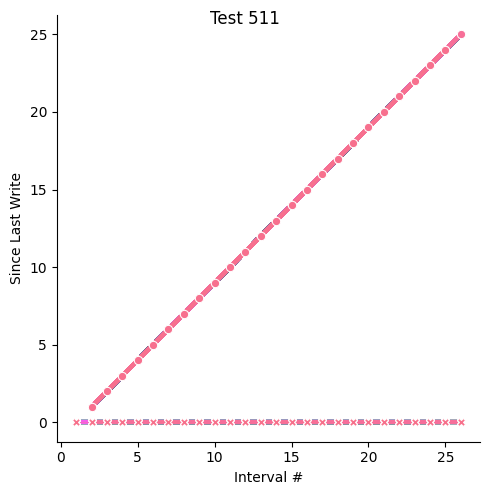

Done with second graph, moving on to the next...


<Figure size 2000x1000 with 0 Axes>

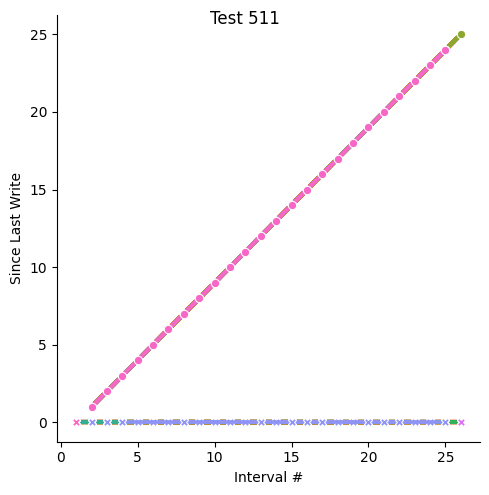

Done with third graph, moving on to the next...


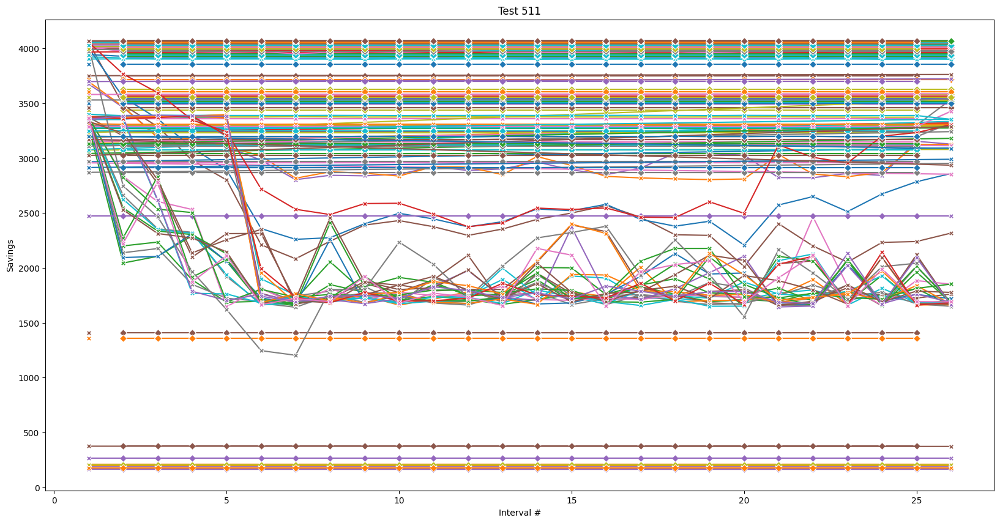

Done with fourth graph, moving on to the next...


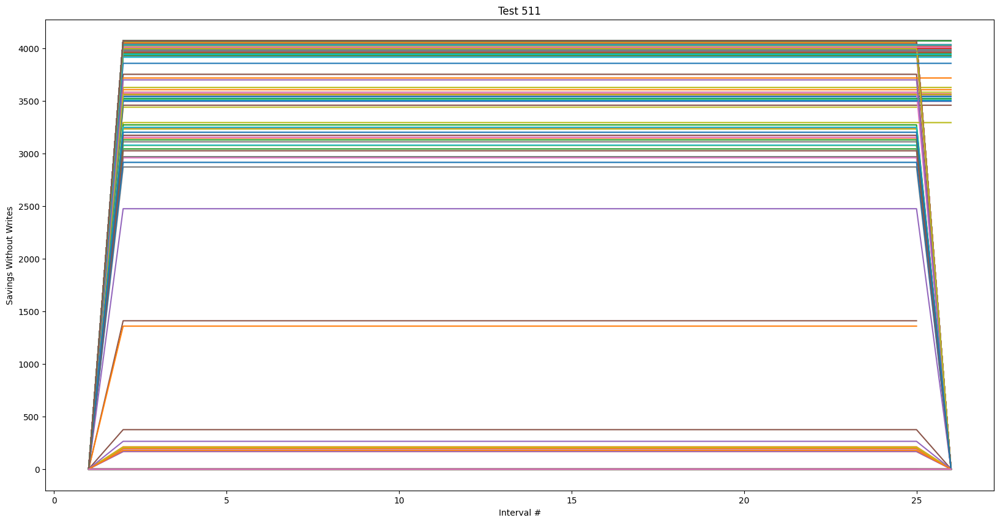

Done with fifth graph, moving on to the next...
Test 519 done
Test 519
Tracked 10002 pages
Sampled 400 pages
Total pages for intervals: [400]
Total written for intervals: [400]
Total new for intervals: [400]
10.0% done
20.0% done
30.0% done
40.0% done
50.0% done
60.0% done
70.0% done
80.0% done
90.0% done
100.0% done
Done processing data for test 519
Graphing data...


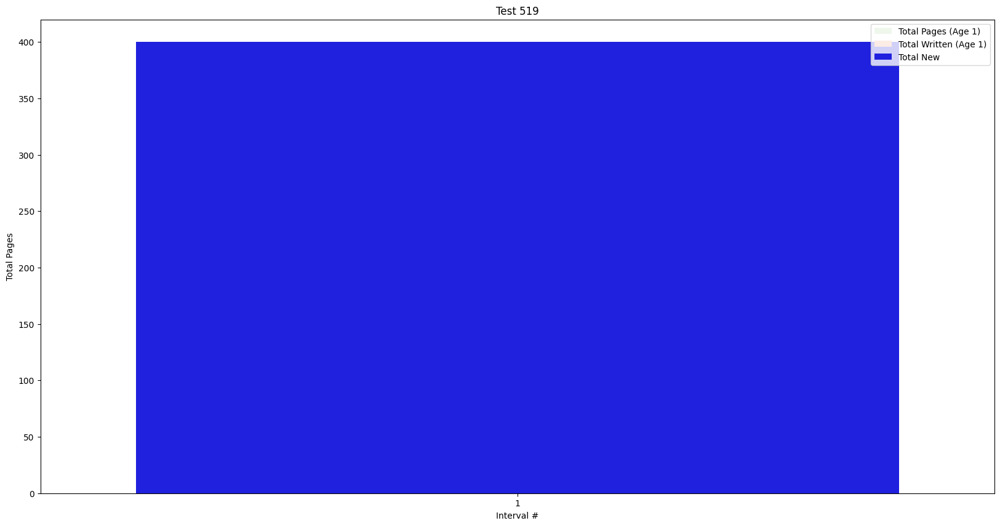

Done with first graph, moving on to the next...


<Figure size 2000x1000 with 0 Axes>

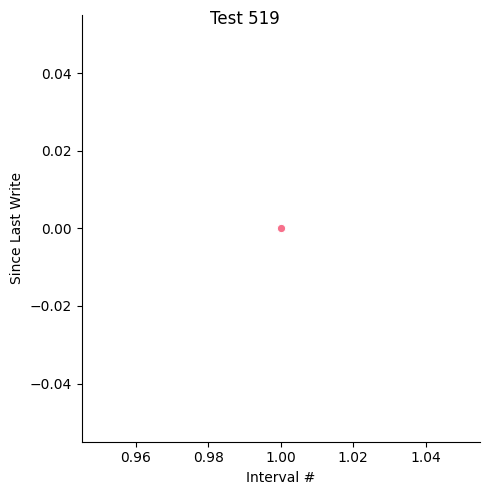

Done with second graph, moving on to the next...


<Figure size 2000x1000 with 0 Axes>

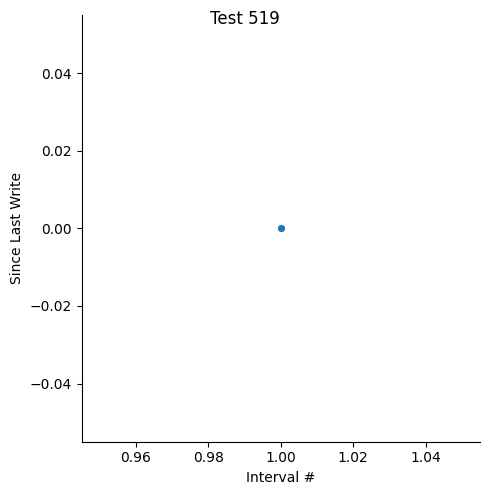

Done with third graph, moving on to the next...


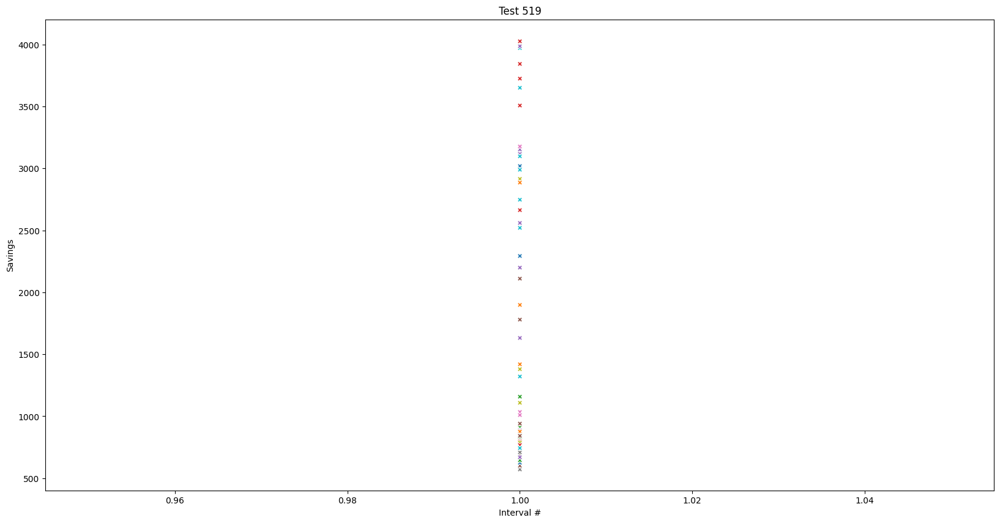

Done with fourth graph, moving on to the next...


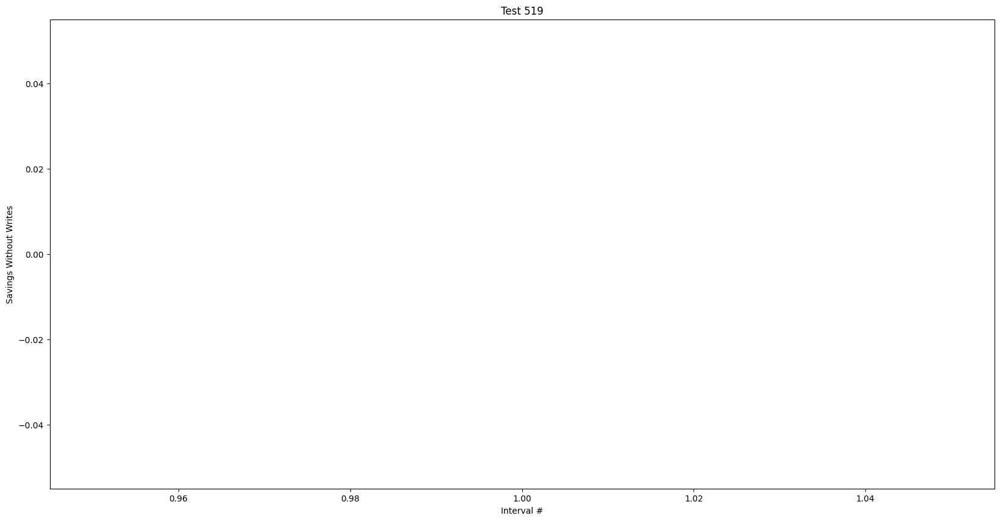

Done with fifth graph, moving on to the next...
Test 523 done
Test 523
Tracked 110 pages
Sampled 110 pages
Total pages for intervals: [90, 90, 90, 90, 90, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 95, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 76, 7

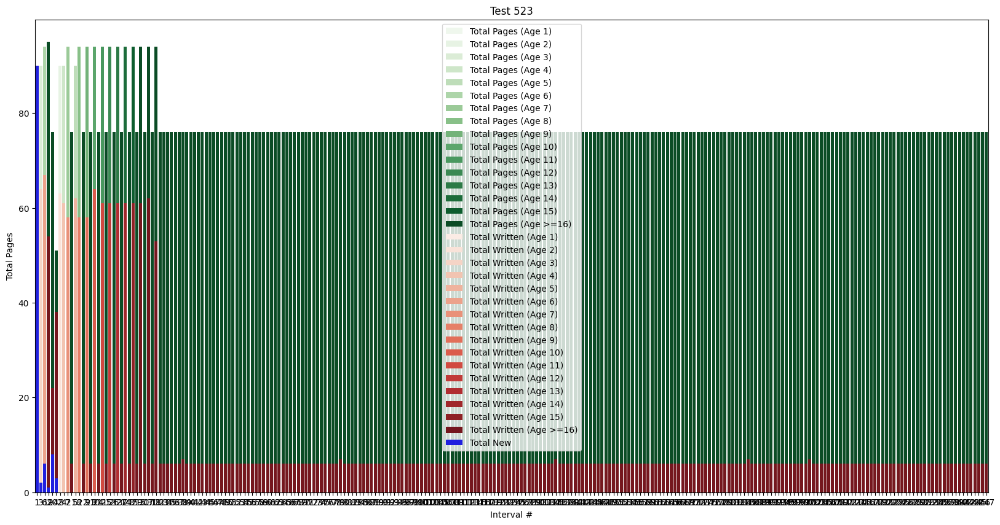

Done with first graph, moving on to the next...


<Figure size 2000x1000 with 0 Axes>

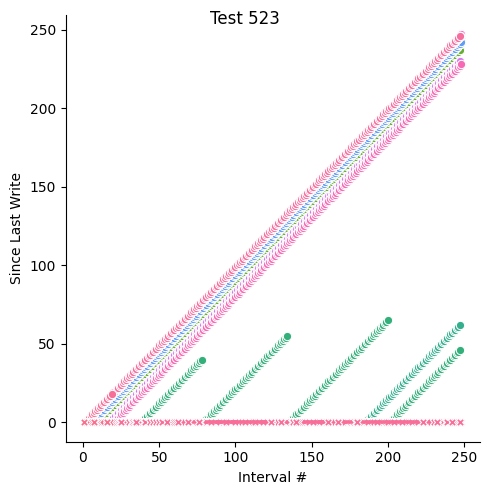

Done with second graph, moving on to the next...


<Figure size 2000x1000 with 0 Axes>

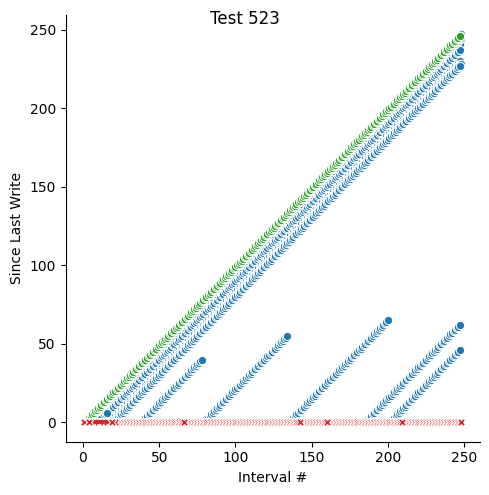

Done with third graph, moving on to the next...


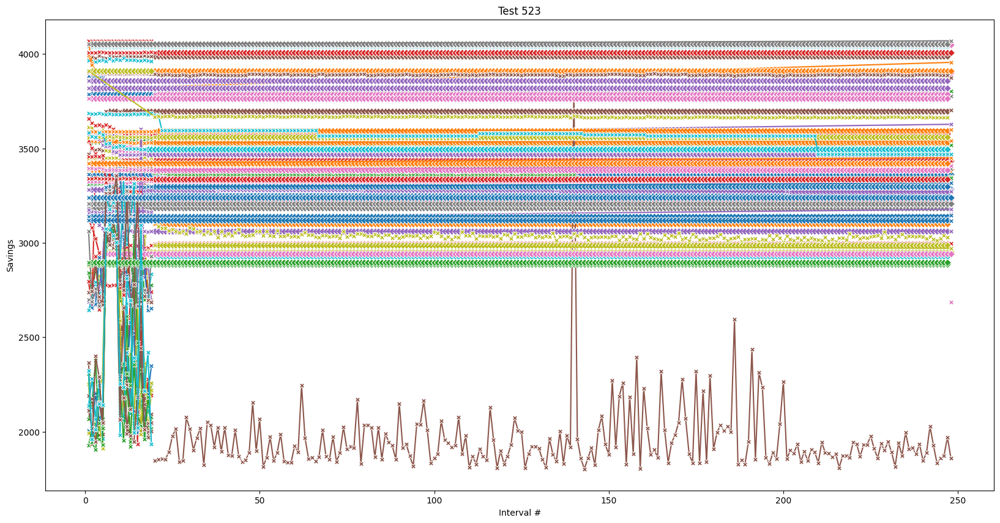

Done with fourth graph, moving on to the next...


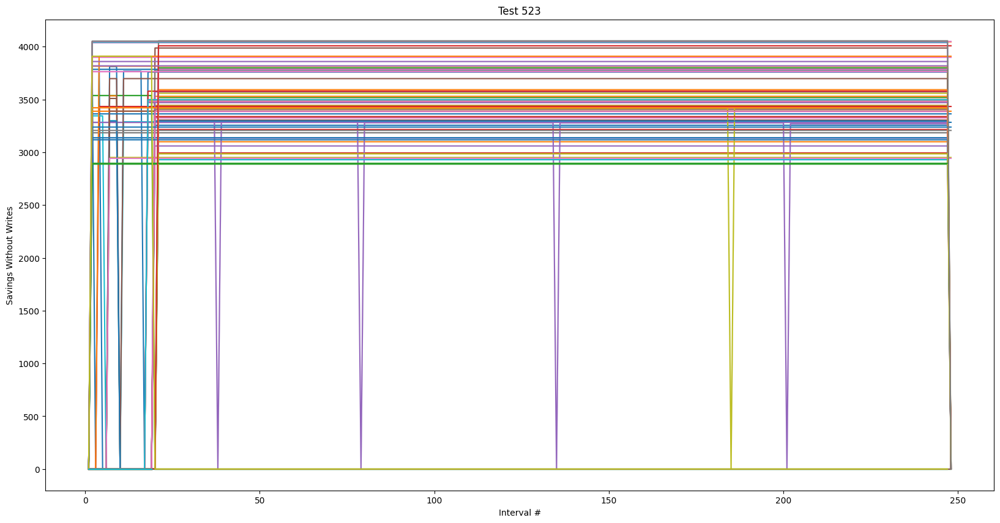

Done with fifth graph, moving on to the next...
Test 525 done
Test 525
Tracked 11632 pages
Sampled 400 pages
Total pages for intervals: [400, 314]
Total written for intervals: [400, 266]
Total new for intervals: [400, 0]
10.0% done
20.0% done
30.0% done
40.0% done
50.0% done
60.0% done
70.0% done
80.0% done
90.0% done
100.0% done
Done processing data for test 525
Graphing data...


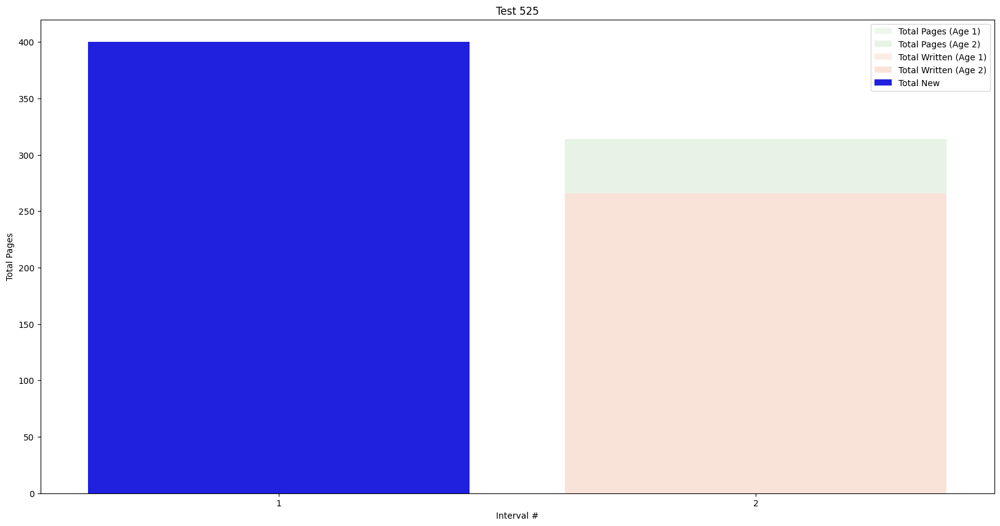

Done with first graph, moving on to the next...


<Figure size 2000x1000 with 0 Axes>

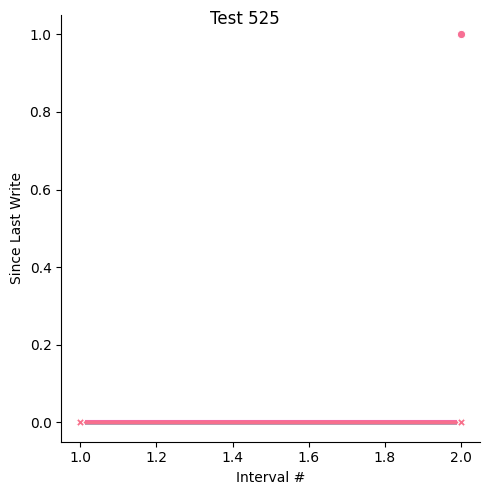

Done with second graph, moving on to the next...


<Figure size 2000x1000 with 0 Axes>

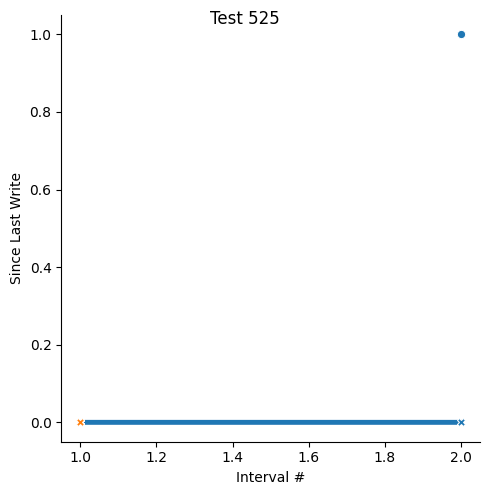

Done with third graph, moving on to the next...


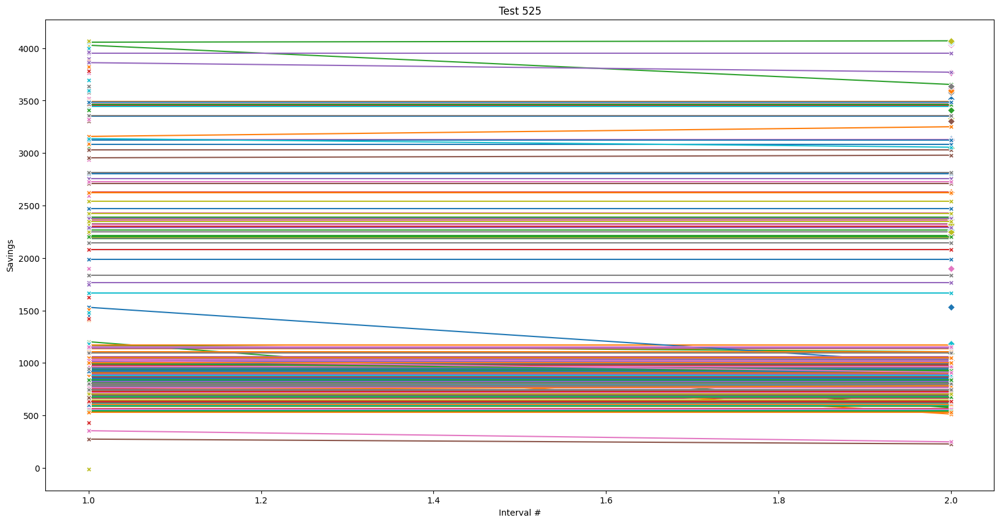

Done with fourth graph, moving on to the next...


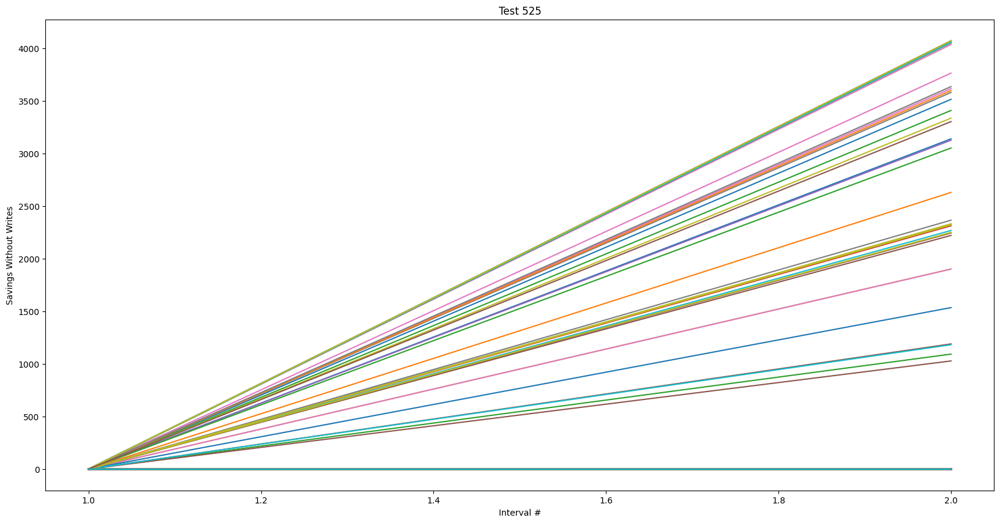

Done with fifth graph, moving on to the next...
Test 526 done
Test 526
Tracked 1798 pages
Sampled 400 pages
Total pages for intervals: [182, 199, 277, 233, 270, 294, 322, 330, 92]
Total written for intervals: [182, 17, 95, 34, 66, 75, 93, 80, 2]
Total new for intervals: [182, 17, 86, 18, 37, 24, 28, 8, 0]
10.0% done
20.0% done
30.0% done
40.0% done
50.0% done
60.0% done
70.0% done
80.0% done
90.0% done
100.0% done
Done processing data for test 526
Graphing data...


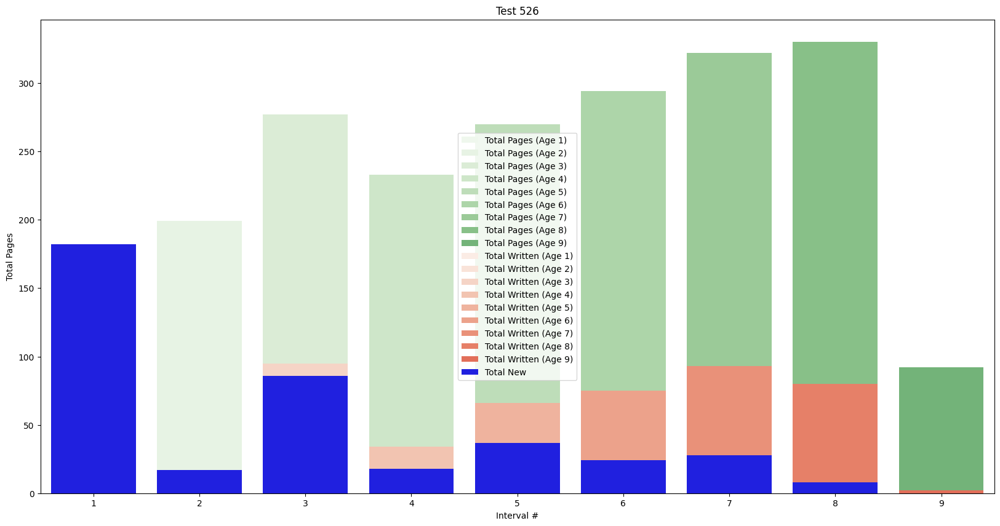

Done with first graph, moving on to the next...


<Figure size 2000x1000 with 0 Axes>

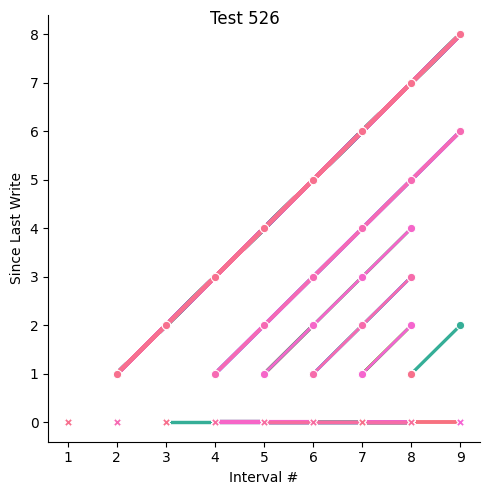

Done with second graph, moving on to the next...


<Figure size 2000x1000 with 0 Axes>

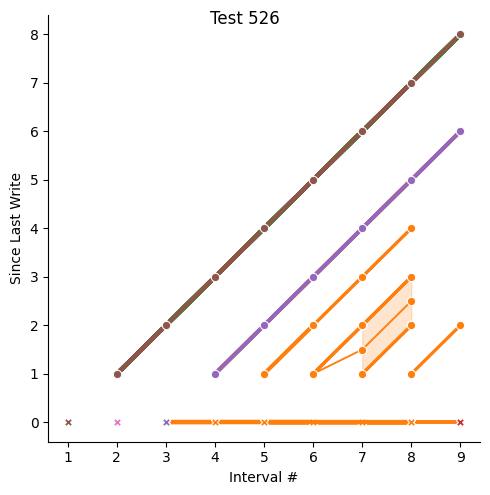

Done with third graph, moving on to the next...


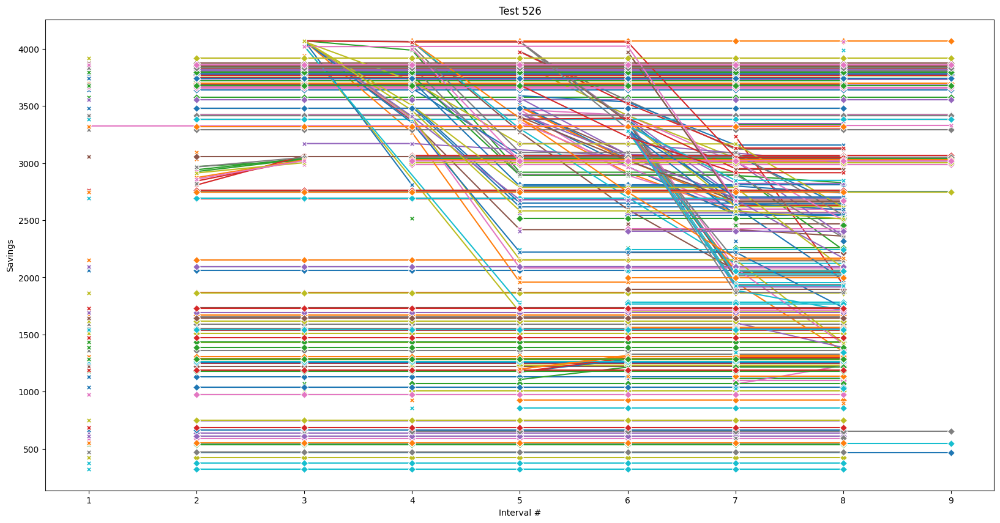

Done with fourth graph, moving on to the next...


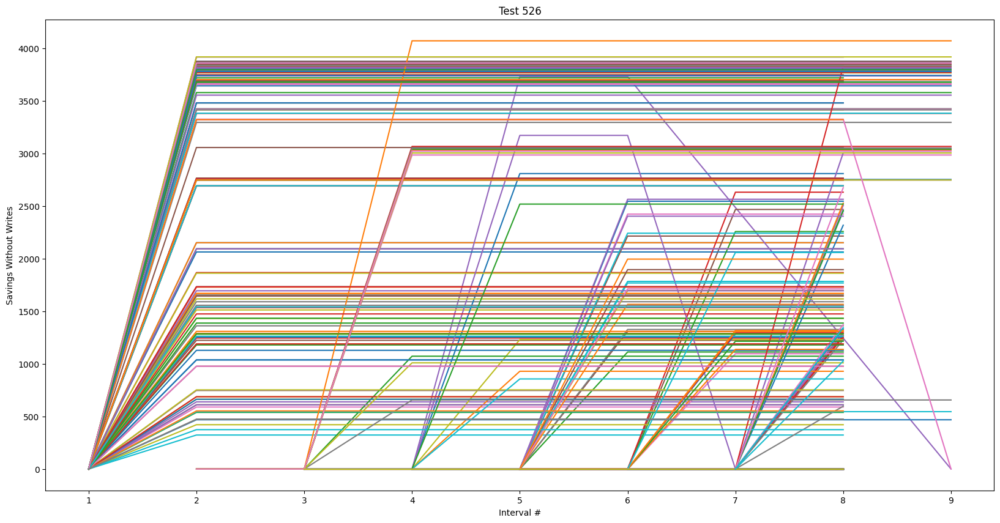

Done with fifth graph, moving on to the next...
Test 531 done
Test 531
Tracked 10002 pages
Sampled 400 pages
Total pages for intervals: [400, 400]
Total written for intervals: [400, 0]
Total new for intervals: [400, 0]
10.0% done
20.0% done
30.0% done
40.0% done
50.0% done
60.0% done
70.0% done
80.0% done
90.0% done
100.0% done
Done processing data for test 531
Graphing data...


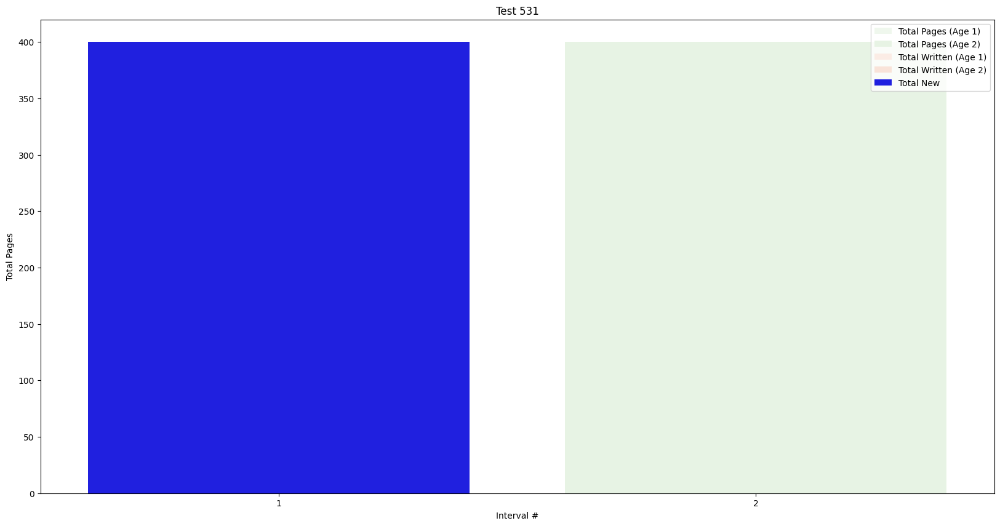

Done with first graph, moving on to the next...


<Figure size 2000x1000 with 0 Axes>

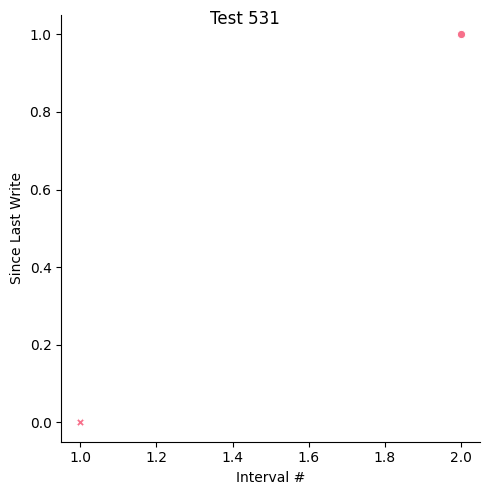

Done with second graph, moving on to the next...


<Figure size 2000x1000 with 0 Axes>

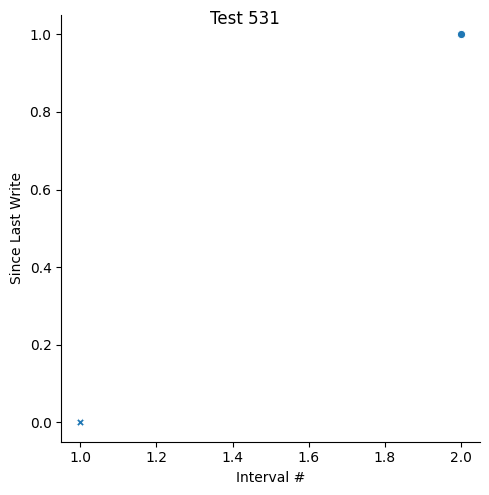

Done with third graph, moving on to the next...


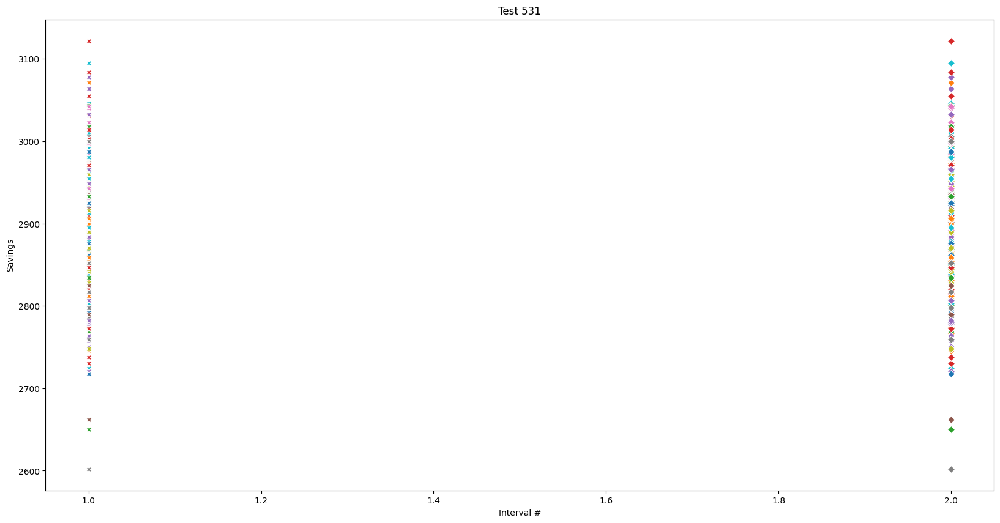

Done with fourth graph, moving on to the next...


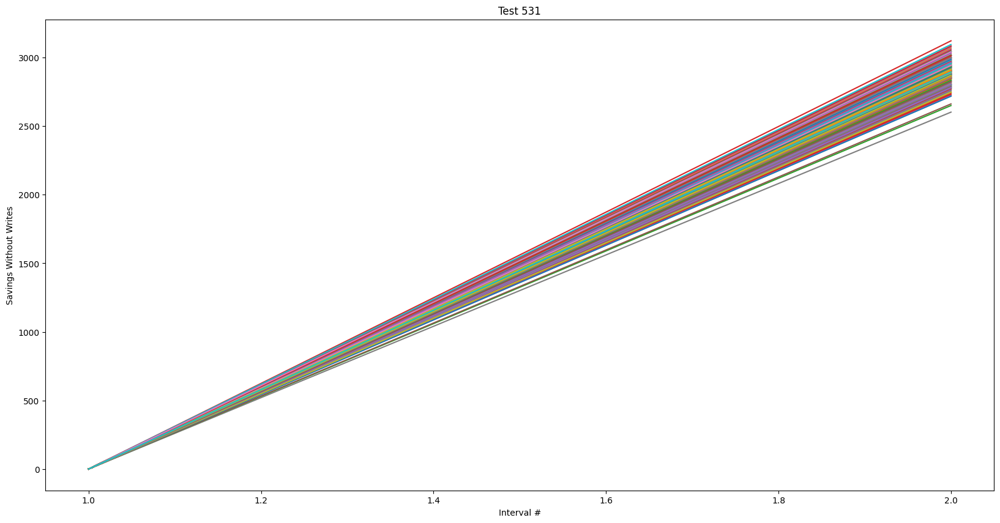

Done with fifth graph, moving on to the next...
Test 538 done
Test 538
Tracked 2240 pages
Sampled 400 pages
Total pages for intervals: [175, 228]
Total written for intervals: [175, 228]
Total new for intervals: [175, 225]
10.0% done
20.0% done
30.0% done
40.0% done
50.0% done
60.0% done
70.0% done
80.0% done
90.0% done
100.0% done
Done processing data for test 538
Graphing data...


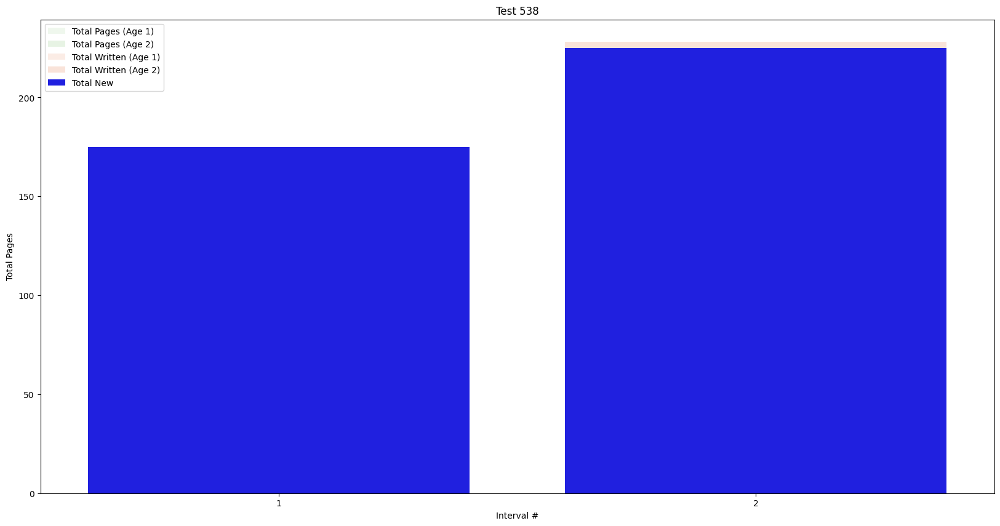

Done with first graph, moving on to the next...


<Figure size 2000x1000 with 0 Axes>

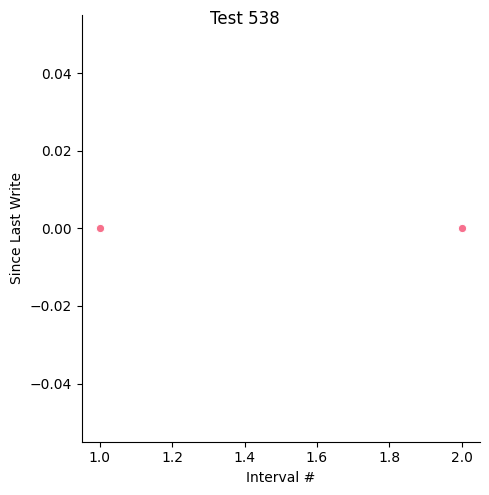

Done with second graph, moving on to the next...


<Figure size 2000x1000 with 0 Axes>

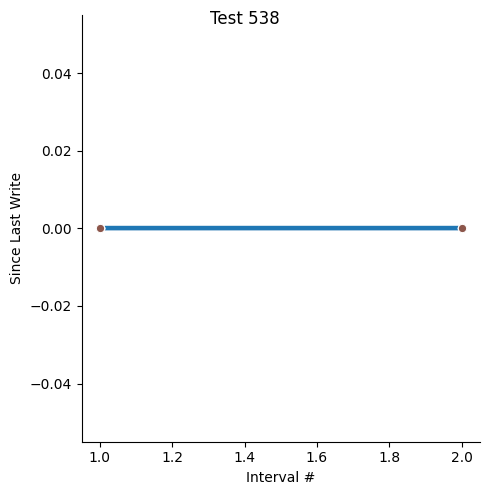

Done with third graph, moving on to the next...


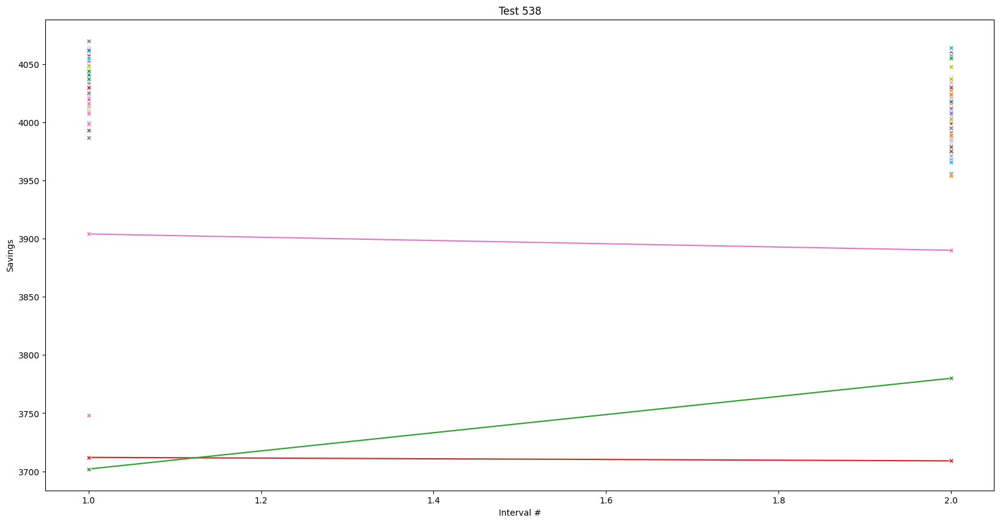

Done with fourth graph, moving on to the next...


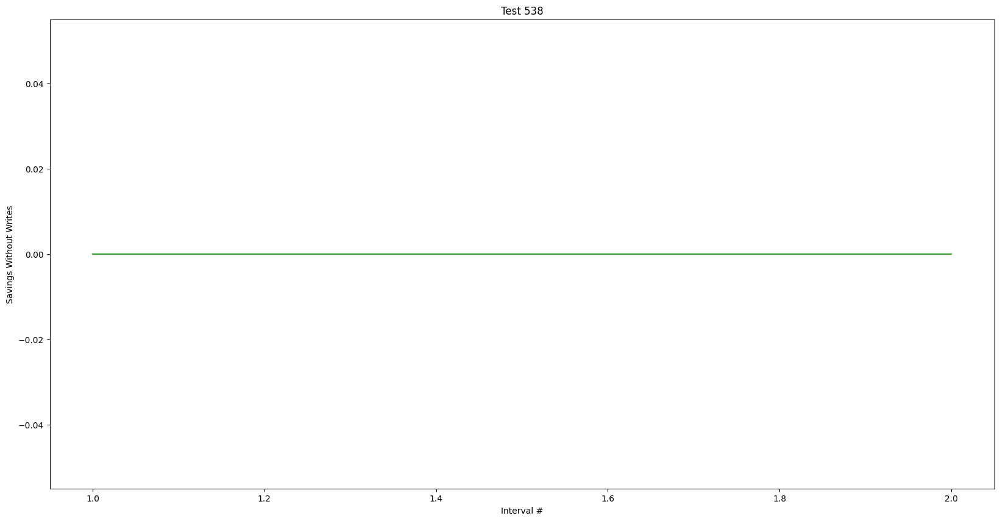

Done with fifth graph, moving on to the next...
Test 541 done
Test 541
Tracked 2607 pages
Sampled 400 pages
Total pages for intervals: [263, 268, 273, 275, 278, 281, 287, 306, 314, 319, 329, 337, 343, 350, 367, 260]
Total written for intervals: [263, 152, 155, 159, 162, 165, 169, 186, 194, 191, 198, 204, 211, 225, 242, 157]
Total new for intervals: [263, 5, 5, 2, 3, 3, 6, 50, 8, 6, 10, 8, 7, 7, 17, 0]
10.0% done
20.0% done
30.0% done
40.0% done
50.0% done
60.0% done
70.0% done
80.0% done
90.0% done
100.0% done
Done processing data for test 541
Graphing data...


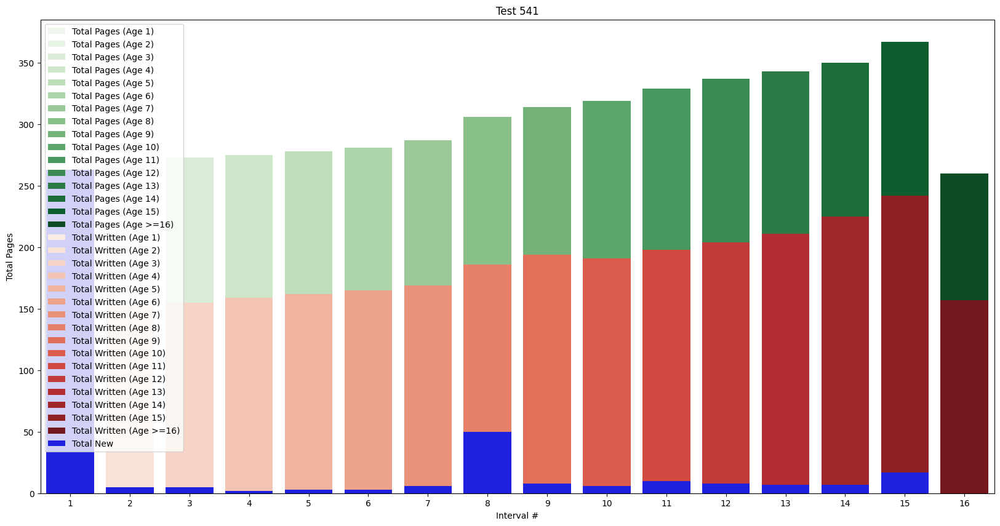

Done with first graph, moving on to the next...


<Figure size 2000x1000 with 0 Axes>

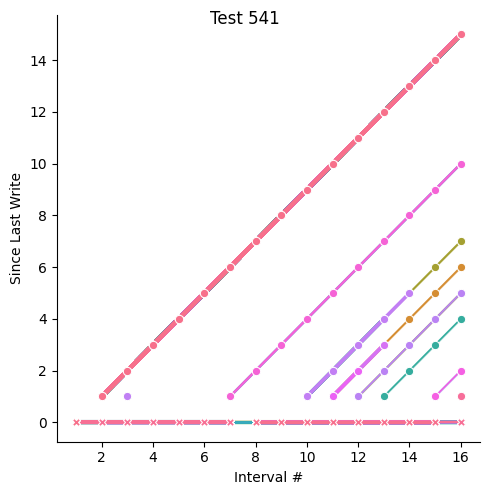

Done with second graph, moving on to the next...


<Figure size 2000x1000 with 0 Axes>

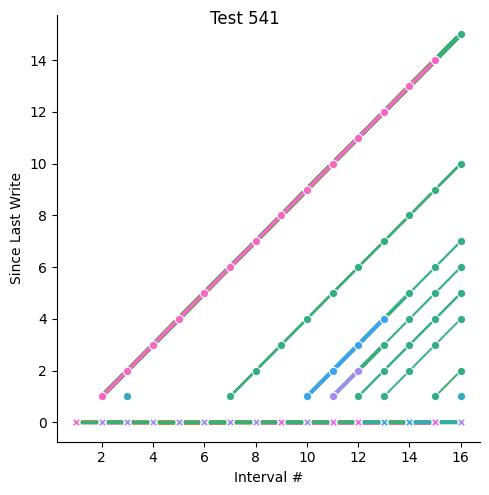

Done with third graph, moving on to the next...


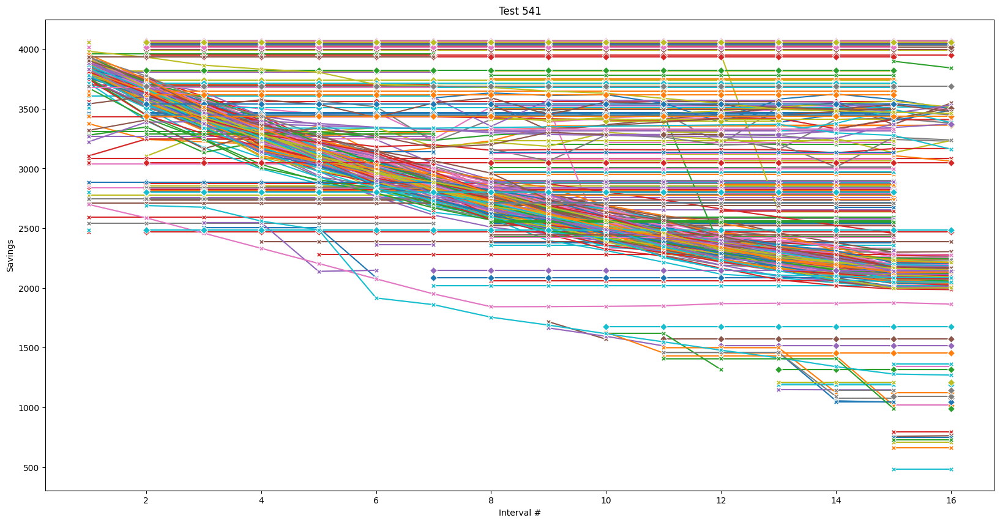

Done with fourth graph, moving on to the next...


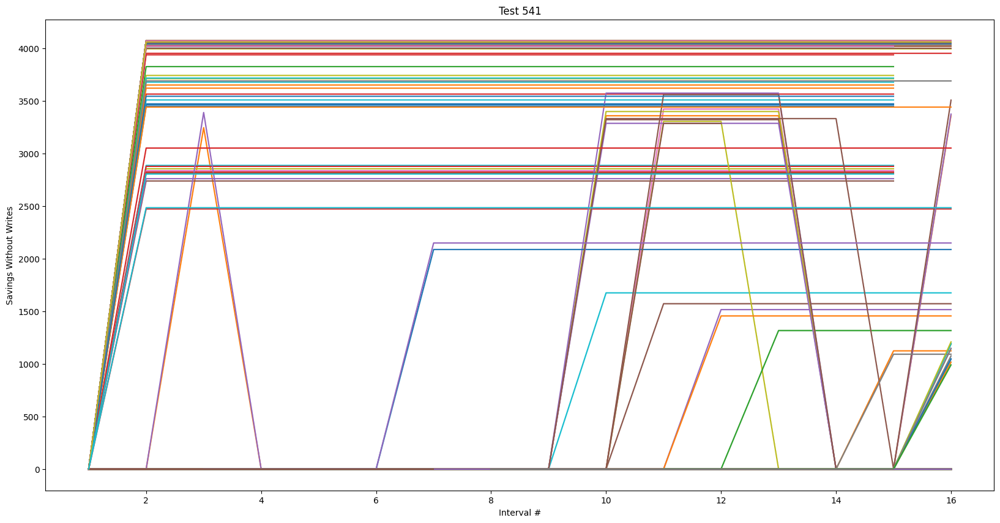

Done with fifth graph, moving on to the next...
Test 544 done
Test 544
Tracked 682 pages
Sampled 400 pages
Total pages for intervals: [399, 399, 399, 395, 355]
Total written for intervals: [399, 74, 74, 302, 28]
Total new for intervals: [399, 0, 0, 1, 0]
10.0% done
20.0% done
30.0% done
40.0% done
50.0% done
60.0% done
70.0% done
80.0% done
90.0% done
100.0% done
Done processing data for test 544
Graphing data...


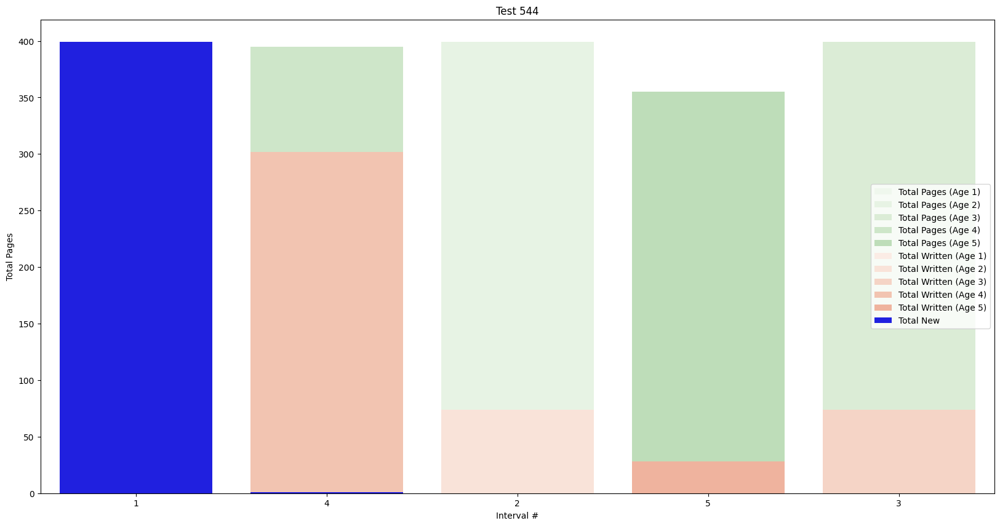

Done with first graph, moving on to the next...


<Figure size 2000x1000 with 0 Axes>

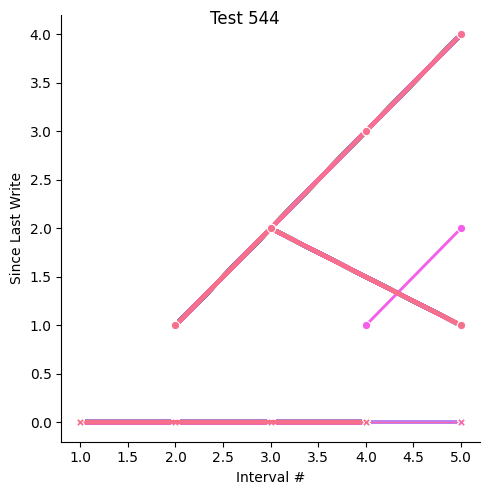

Done with second graph, moving on to the next...


<Figure size 2000x1000 with 0 Axes>

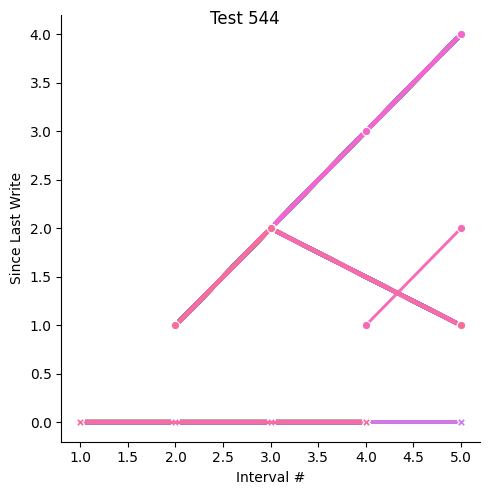

Done with third graph, moving on to the next...


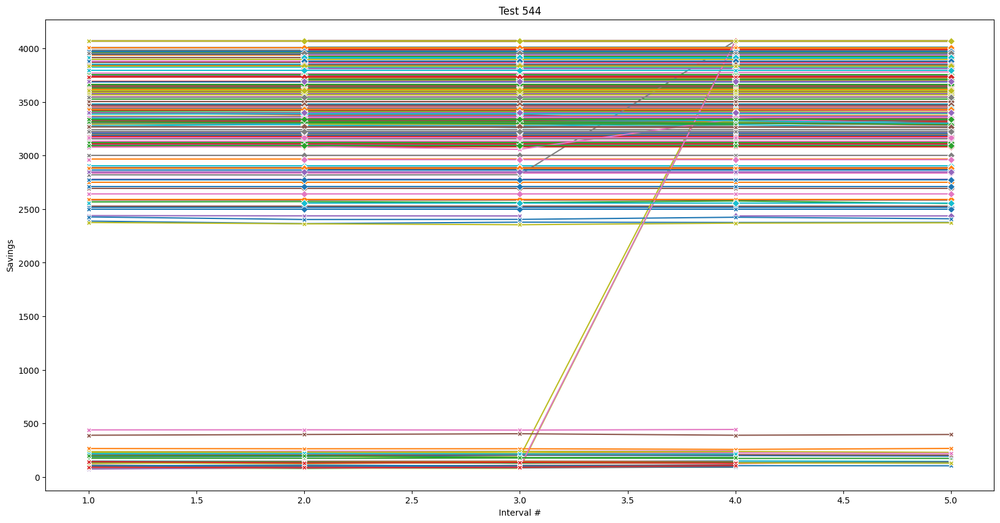

Done with fourth graph, moving on to the next...


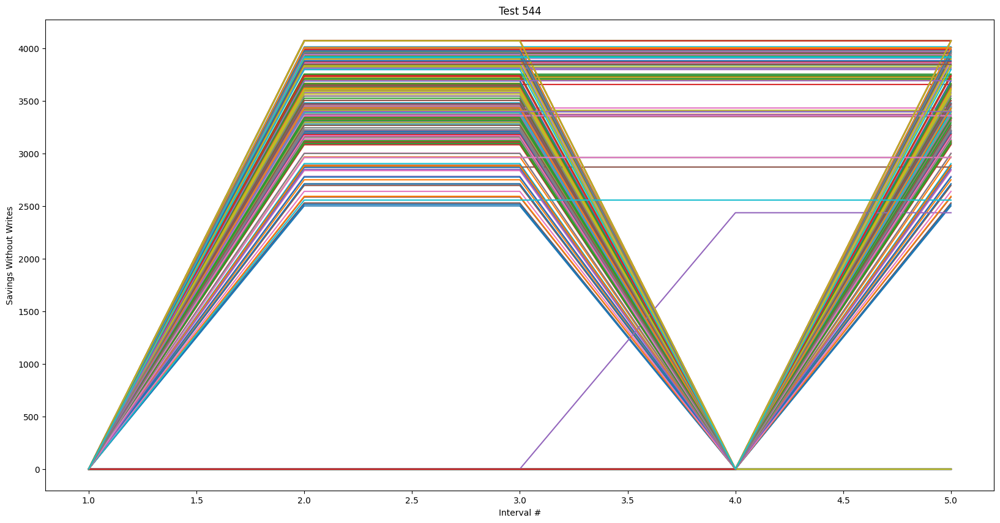

Done with fifth graph, moving on to the next...
Test 549 done
Test 549
Tracked 104266 pages
Sampled 400 pages
Total pages for intervals: [3, 3, 4, 6, 9, 10, 13, 16, 22, 26, 29, 32, 36, 40, 40, 42, 45, 50, 52, 59, 62, 62, 65, 73, 73, 76, 77, 79, 83, 86, 90, 97, 101, 270, 76]
Total written for intervals: [3, 3, 4, 6, 9, 10, 13, 16, 22, 26, 29, 32, 36, 40, 40, 42, 45, 50, 52, 59, 62, 62, 65, 73, 73, 76, 77, 79, 83, 86, 90, 97, 101, 270, 0]
Total new for intervals: [3, 0, 1, 2, 3, 1, 3, 3, 6, 4, 3, 3, 4, 4, 0, 2, 3, 5, 2, 7, 3, 0, 3, 8, 0, 3, 1, 2, 4, 3, 4, 7, 4, 266, 33]
10.0% done
20.0% done
30.0% done
40.0% done
50.0% done
60.0% done
70.0% done
80.0% done
90.0% done
100.0% done
Done processing data for test 549
Graphing data...


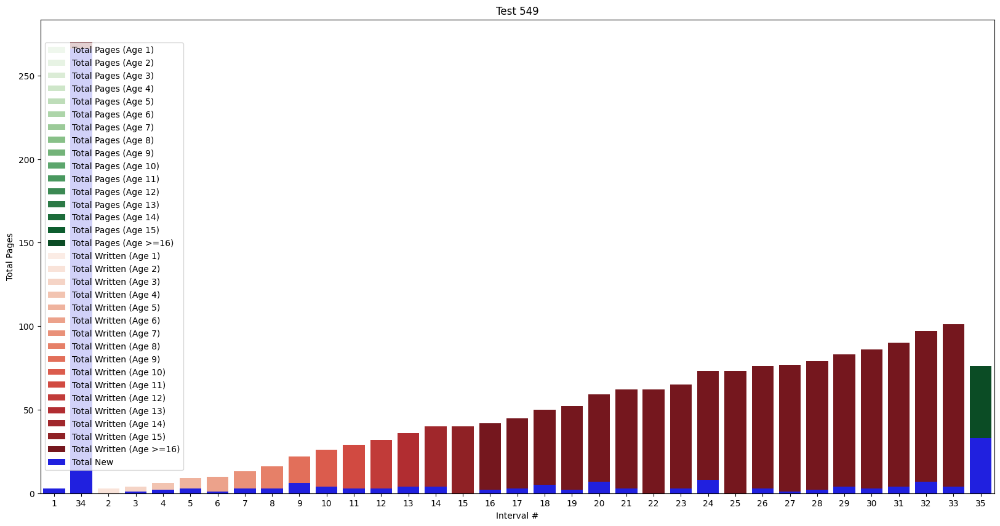

Done with first graph, moving on to the next...


<Figure size 2000x1000 with 0 Axes>

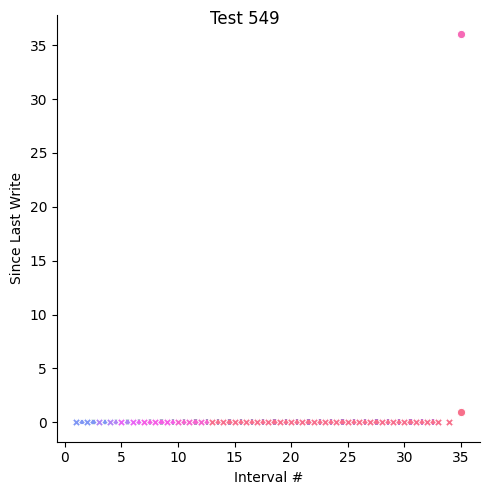

Done with second graph, moving on to the next...


<Figure size 2000x1000 with 0 Axes>

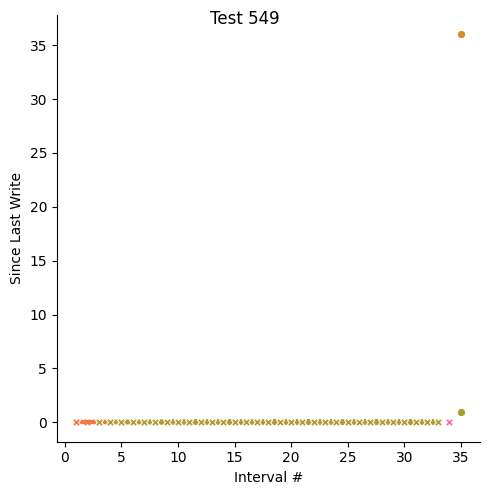

Done with third graph, moving on to the next...


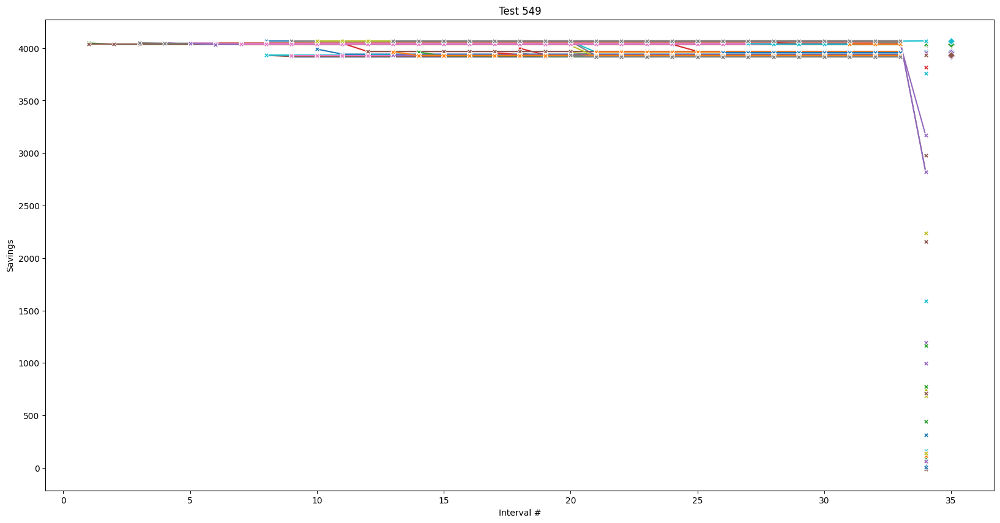

Done with fourth graph, moving on to the next...


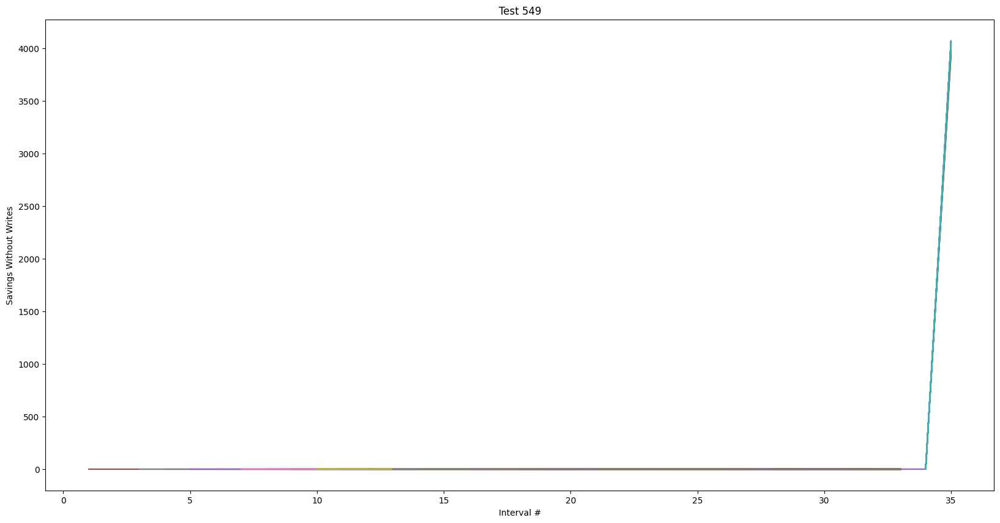

Done with fifth graph, moving on to the next...
Test 557 done
Test 557
Tracked 20004 pages
Sampled 400 pages
Total pages for intervals: [400]
Total written for intervals: [400]
Total new for intervals: [400]
10.0% done
20.0% done
30.0% done
40.0% done
50.0% done
60.0% done
70.0% done
80.0% done
90.0% done
100.0% done
Done processing data for test 557
Graphing data...


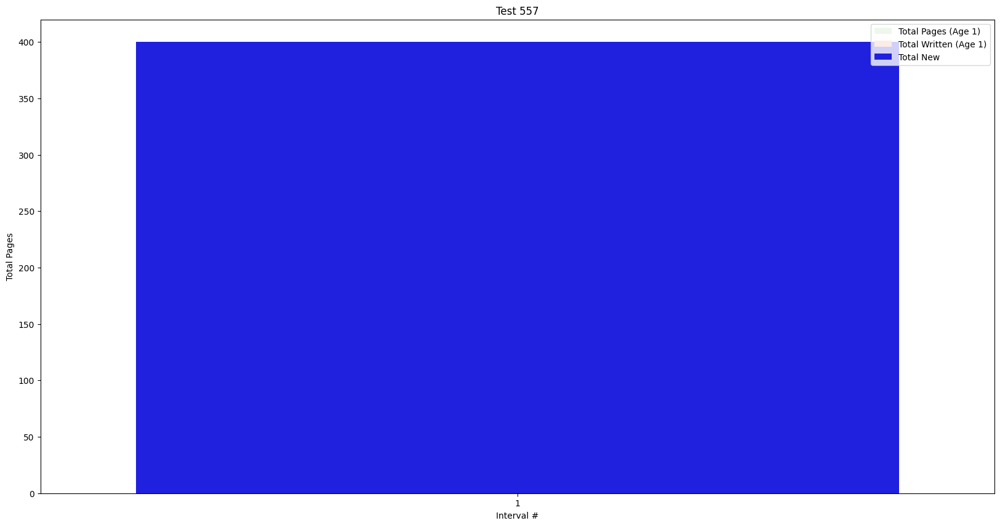

Done with first graph, moving on to the next...


<Figure size 2000x1000 with 0 Axes>

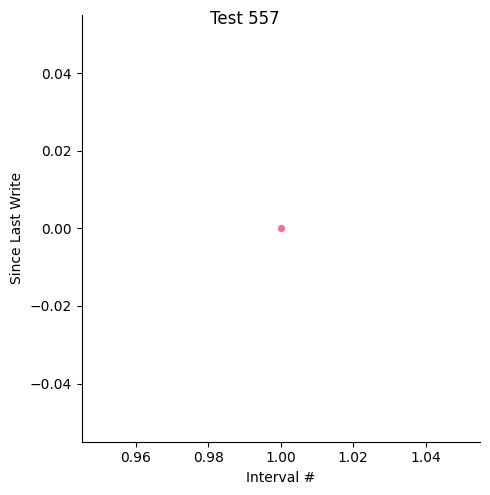

Done with second graph, moving on to the next...


<Figure size 2000x1000 with 0 Axes>

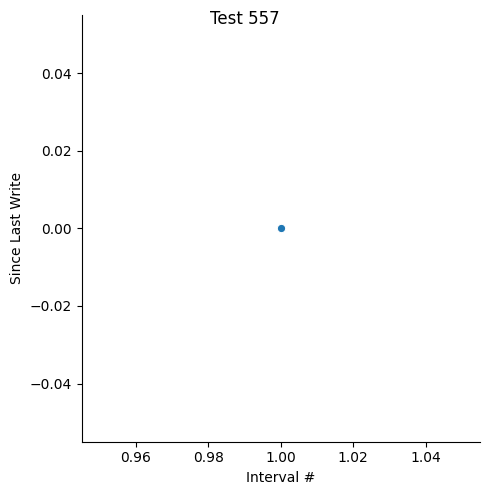

Done with third graph, moving on to the next...


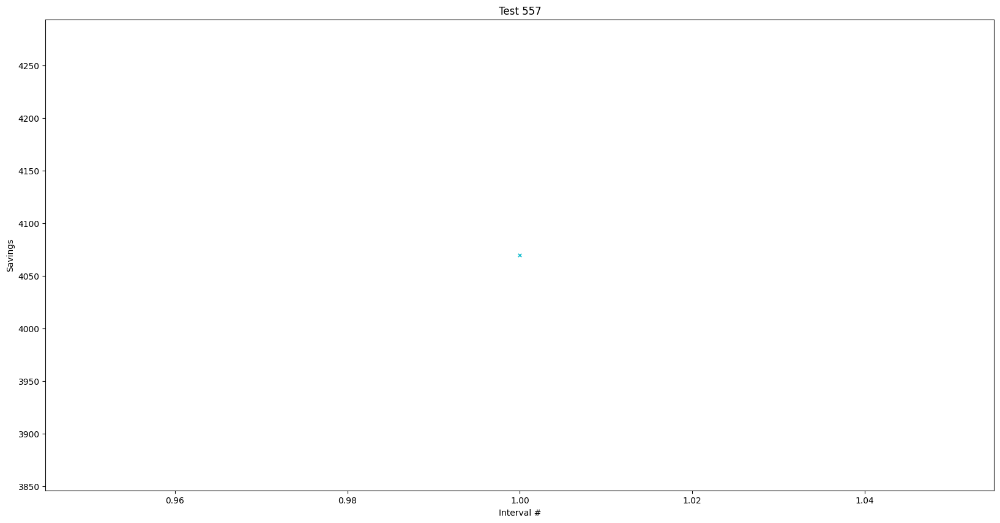

Done with fourth graph, moving on to the next...


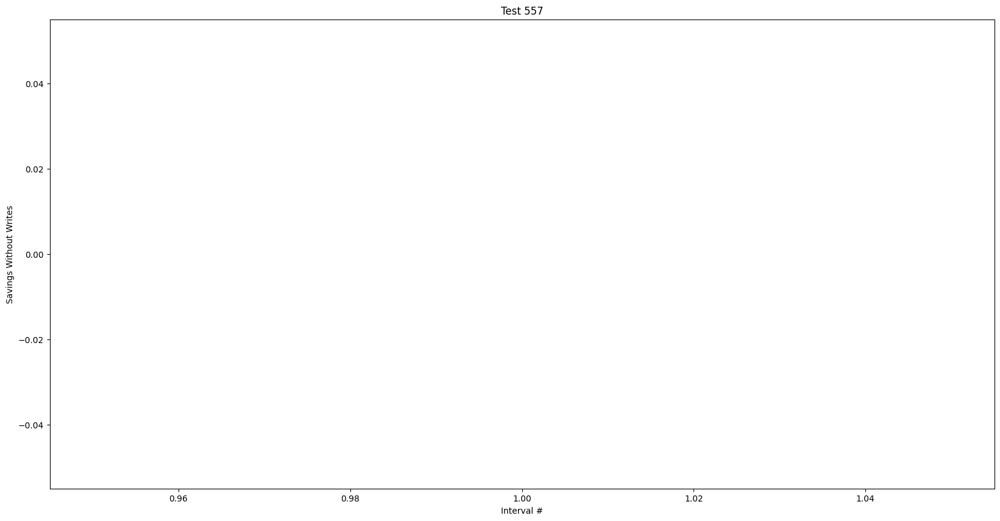

Done with fifth graph, moving on to the next...


In [4]:
if 'tests' in locals() and 'test_page_data' in locals():
    print("Tests already loaded")
else:
    # Get the tests from the data
    tests = list(all_data.keys())
    # Get the number of tests
    print("Number of tests: " + str(len(tests)))


    # Iterate over the tests and graph the results
    for test_number in tests:
        # Get the data for the test
        test_data = all_data[test_number]

        # For each test interval, make the data keyed on each object's address.
        # If it is reallocated (its "Is new?" column is set), treat it as a new allocation.
        page_data = {}
        for index, row in test_data.iterrows():
            address = row["Physical Page Address"]
            site = row["Allocation Site"]
            if address not in page_data:
                page_data[address] = Page(address, site)
            page_data[address].add_row(row)

        # Store the allocation data for this test
        print("Test " + str(test_number) + " done")

        try:
            # Get the data for each object
            print("Test " + str(test_number))
            result_data = pd.DataFrame()
            pages = set(page_data.values())

            if len(page_data) == 0:
                print("No pages to process for test " + str(test_number))
                continue

            # Just do the top 1000 sized objects
            print("Tracked " + str(len(pages)) + " pages")
            max_tracked = 400
            if len(pages) > max_tracked:
                # Sample randomly
                pages = np.random.choice(list(pages), max_tracked, replace=False)
            print("Sampled " + str(len(pages)) + " pages")

            # min_interval = int(all_data[test_number]["Interval #"].min())
            # max_interval = int(all_data[test_number]["Interval #"].max())
            # Get the min and max interval from the pages
            min_interval = min([p.get_first_interval() for p in pages])
            max_interval = max([p.get_last_interval() for p in pages])

            total_pages = [
                sum([1 for p in pages if p.get_first_interval() <= i and p.get_last_interval() >= i]) for i in range(min_interval, max_interval + 1)
            ]
            total_written = [
                sum([1 for p in pages if p.was_written_to_during_interval(i)]) for i in range(min_interval, max_interval + 1)
            ]
            total_new = [
                sum([1 for p in pages if p.get_first_interval() == i]) for i in range(min_interval, max_interval + 1)
            ]

            print("Total pages for intervals: " + str(total_pages))
            print("Total written for intervals: " + str(total_written))
            print("Total new for intervals: " + str(total_new))
            # pages = sorted(pages, key=lambda o: o.get_physical_size_in_bytes(), reverse=True)[:max_tracked]

            for i, p in enumerate(pages):
                percent_done = (int(i + 1) * 100 / len(pages))
                if percent_done % 10 == 0:
                    print(str(percent_done) + "% done") 

                savings = [
                    row["Compression Savings (bytes)"] for row in p.data
                ]
                savings_without_writes = [
                    row["Compression Savings (bytes)"] if not row["Written During This Interval?"] else 0 for row in p.data
                ]
                # since_last_write = [i - p.get_interval_of_last_write(i) for i in range(p.get_first_interval(), p.get_last_interval() + 1)]
                since_last_write = [row["Interval #"] - p.get_interval_of_last_write(row["Interval #"]) for row in p.data]
                result_data = pd.concat([result_data, pd.DataFrame({
                    "Interval #": [row["Interval #"] for row in p.data],
                    "Total Pages": [total_pages[row["Interval #"] - min_interval] for row in p.data],
                    "Total Written": [total_written[row["Interval #"] - min_interval] for row in p.data],
                    "Total New": [total_new[row["Interval #"] - min_interval] for row in p.data],
                    "Written": [int(row["Written During This Interval?"]) for row in p.data],
                    "New": [int(row["Is new?"]) for row in p.data],
                    "Percent Savings": [
                        # Zero if the object was written to, otherwise the amount of memory saved by compressing the physical pages
                        row["Compression Savings (bytes)"] if not row["Written During This Interval?"] else 0 for row in p.data
                    ],
                    "Savings": savings,
                    "Savings Without Writes": savings_without_writes,
                    "Since Last Write": since_last_write,
                    "Age": [row["Age (intervals)"] for row in p.data],
                    "Page": repr(p),
                    "Site": p.get_site(),
                })])
            print("Done processing data for test " + str(test_number))
            print("Graphing data...")

            # Plot the data
            # sns.barplot(x="Interval #", y="Total Objects", data=object_data, color="green", legend="full")
            # sns.barplot(x="Interval #", y="Total Written", data=object_data, color="red", legend="full")
            # sns.barplot(x="Interval #", y="Total New", data=object_data, color="blue", legend="full")

            # Create a multibar plot
            plt.figure(figsize=(20,10))
            plt.title("Test " + str(test_number))

            age_classes = 16
            for age in range(1, age_classes + 1):
                if age < age_classes:
                    sns.barplot(x="Interval #", y="Total Pages", data=result_data[result_data["Age"] == age], color=sns.color_palette("Greens", 16)[age-1], label="Total Pages (Age " + str(age) + ")")
                else:
                    sns.barplot(x="Interval #", y="Total Pages", data=result_data[result_data["Age"] >= age], color=sns.color_palette("Greens", 16)[age-1], label="Total Pages (Age >=" + str(age) + ")")
            
            for age in range(1, age_classes + 1):
                # Red colors
                if age < age_classes:
                    sns.barplot(x="Interval #", y="Total Written", data=result_data[result_data["Age"] == age], color=sns.color_palette("Reds", 16)[age-1], label="Total Written (Age " + str(age) + ")")
                else:
                    sns.barplot(x="Interval #", y="Total Written", data=result_data[result_data["Age"] >= age], color=sns.color_palette("Reds", 16)[age-1], label="Total Written (Age >=" + str(age) + ")")
            # for age in range(1, age_classes + 1):
            #     # Blue colors
            #     if age < age_classes:
            #         sns.barplot(x="Interval #", y="Total New", data=result_data[result_data["Age"] == age], color=sns.color_palette("Blues", 16)[age-1], label="Total New (Age " + str(age) + ")")
            #     else:
            #         sns.barplot(x="Interval #", y="Total New", data=result_data[result_data["Age"] >= age], color=sns.color_palette("Blues", 16)[age-1], label="Total New (Age >=" + str(age) + ")")
            # total_pages = sns.barplot(x="Interval #", y="Total Pages", data=result_data, color="green", label="Total Pages")
            # total_hot = sns.barplot(x="Interval #", y="Total Written", data=result_data, color="red", label="Total Written")
            total_new = sns.barplot(x="Interval #", y="Total New", data=result_data, color="blue", label="Total New")
            # plt.legend(handles=[total_obj, total_hot, total_new], labels=["Total Objects", "Total Written", "Total New"])
            plt.show()
            print("Done with first graph, moving on to the next...")

            # Show
            # sns.barplot(x="Interval #", y="Percent Savings", data=object_data, color="green", ax=ax)
            # sns.lineplot(x="Interval #", y="Written", data=object_data, ax=ax)
            plt.figure(figsize=(20,10))
            g = sns.relplot(
                data=result_data,
                x="Interval #", y="Since Last Write", kind="line", hue="Page", size="Savings", style="Written", markers=True, dashes=False, legend=False
            )
            # Set the title
            g.fig.suptitle("Test " + str(test_number))
            # plt.legend()
            plt.show()
            print("Done with second graph, moving on to the next...")

            plt.figure(figsize=(20,10))
            g = sns.relplot(
                data=result_data,
                x="Interval #", y="Since Last Write", kind="line", hue="Site", size="Savings", style="Written", markers=True, dashes=False, legend=False
            )
            g.fig.suptitle("Test " + str(test_number))
            # plt.legend()
            plt.show()
            print("Done with third graph, moving on to the next...")

            plt.figure(figsize=(20,10))
            plt.title("Test " + str(test_number))

            for p in pages:
                sns.lineplot(x="Interval #", y="Savings", data=result_data[result_data["Page"] == repr(p)], label=repr(p), style="Written", legend=False, markers={1: "X", 0: "D"}, dashes=False)
            plt.show()
            print("Done with fourth graph, moving on to the next...")

            plt.figure(figsize=(20,10))
            plt.title("Test " + str(test_number))
            for p in pages:
                sns.lineplot(x="Interval #", y="Savings Without Writes", data=result_data[result_data["Page"] == repr(p)], label=repr(p), markers=True, dashes=False, legend=False)
            plt.show()
            print("Done with fifth graph, moving on to the next...")
        except Exception as e:
            print("Error processing test " + str(test_number) + ": " + str(e))
            continue


### 3.1.1 Divide the data into information about each object

In [5]:
# Stop at this cell
exit()

if 'tests' in locals() and 'test_page_data' in locals():
    print("Tests already loaded")
else:
    # Get the tests from the data
    tests = list(all_data.keys())
    # Get the number of tests
    print("Number of tests: " + str(len(tests)))

    test_page_data = {}

    # Iterate over the tests and graph the results
    for test in tests:
        # Get the data for the test
        test_data = all_data[test]

        # For each test interval, make the data keyed on each object's address.
        # If it is reallocated (its "Is new?" column is set), treat it as a new allocation.
        page_data = {}
        for index, row in test_data.iterrows():
            address = row["Physical Page Address"]
            site = row["Allocation Site"]
            if address not in page_data:
                page_data[address] = Page(address, site)
            page_data[address].add_row(row)

        # Store the allocation data for this test
        test_page_data[test] = page_data
        print("Test " + str(test) + " done")

    for test_number, page_data in test_page_data.items():
        print("Test " + str(test_number))
        for address, address_data in page_data.items():
            print(str(address_data))

Number of tests: 15
Test 500 done
Test 502 done
Test 505 done
Test 508 done
Test 511 done
Test 519 done
Test 523 done
Test 525 done
Test 526 done
Test 531 done
Test 538 done
Test 541 done
Test 544 done
Test 549 done
Test 557 done
Test 500
Page: 0x165562D000
Page: 0x19A1342000
Page: 0x13C74D0000
Page: 0x1902253000
Page: 0x1902256000
Page: 0x16CC67E000
Page: 0x1C9D006000
Page: 0x1902250000
Page: 0x19A1341000
Page: 0x1C9D007000
Page: 0x19A1344000
Page: 0x1260EFF000
Page: 0x156904C000
Page: 0x19A1345000
Page: 0x13C74DD000
Page: 0x1ABB07A000
Page: 0x1C9D000000
Page: 0x13C74C6000
Page: 0x1260F26000
Page: 0x1C26491000
Page: 0x1C26492000
Page: 0x1C9D002000
Page: 0x1C9D003000
Page: 0x13C74C9000
Page: 0x1655624000
Page: 0x1260EFA000
Page: 0x1260EFB000
Page: 0x13C74DB000
Page: 0x201C6F6000
Page: 0x1C26495000
Page: 0x1612D5F000
Page: 0x1260EF8000
Page: 0x1612D5E000
Page: 0x201C6F7000
Page: 0x1ABB079000
Page: 0x13C74DC000
Page: 0x13C74D3000
Page: 0x1C26490000
Page: 0x1ABB07B000
Page: 0x1C9D001000
P

### 3.1.2 Graph the data

In [ ]:
# Now that we have the data, we can graph it
# For each test, we want to graph the following (with the interval # as the x-axis):
#   - The total number of objects (as the y-axis) subdivided into the following categories:
#      - Total number of objects
#      - New objects that interval
#      - Objects that were written to that interval
#
# The graph should be a stacked bar graph, with a segment for each object colored by the category it falls into
# The brightness of each segment should be proportional to the amount of memory saved by compressing the physical pages
# Draw a line through the segments corresponding to each object to show how long the object lived for

for test_number, page_data in test_page_data.items():
    try:
        # Get the data for each object
        print("Test " + str(test_number))
        result_data = pd.DataFrame()
        pages = set(page_data.values())

        if len(page_data) == 0:
            print("No pages to process for test " + str(test_number))
            continue

        # Just do the top 1000 sized objects
        print("Tracked " + str(len(pages)) + " pages")
        max_tracked = 500
        if len(pages) > max_tracked:
            # Sample randomly
            pages = np.random.choice(list(pages), max_tracked, replace=False)
        print("Sampled " + str(len(pages)) + " pages")

        # min_interval = int(all_data[test_number]["Interval #"].min())
        # max_interval = int(all_data[test_number]["Interval #"].max())
        # Get the min and max interval from the pages
        min_interval = min([p.get_first_interval() for p in pages])
        max_interval = max([p.get_last_interval() for p in pages])

        total_pages = [
            sum([1 for p in pages if p.get_first_interval() <= i and p.get_last_interval() >= i]) for i in range(min_interval, max_interval + 1)
        ]
        total_written = [
            sum([1 for p in pages if p.was_written_to_during_interval(i)]) for i in range(min_interval, max_interval + 1)
        ]
        total_new = [
            sum([1 for p in pages if p.get_first_interval() == i]) for i in range(min_interval, max_interval + 1)
        ]

        print("Total pages for intervals: " + str(total_pages))
        print("Total written for intervals: " + str(total_written))
        print("Total new for intervals: " + str(total_new))
        # pages = sorted(pages, key=lambda o: o.get_physical_size_in_bytes(), reverse=True)[:max_tracked]

        for i, p in enumerate(pages):
            percent_done = (int(i + 1) * 100 / len(pages))
            if percent_done % 10 == 0:
                print(str(percent_done) + "% done") 

            savings = [
                row["Compression Savings (bytes)"] for row in p.data
            ]
            savings_without_writes = [
                row["Compression Savings (bytes)"] if not row["Written During This Interval?"] else 0 for row in p.data
            ]
            # since_last_write = [i - p.get_interval_of_last_write(i) for i in range(p.get_first_interval(), p.get_last_interval() + 1)]
            since_last_write = [row["Interval #"] - p.get_interval_of_last_write(row["Interval #"]) for row in p.data]
            result_data = pd.concat([result_data, pd.DataFrame({
                "Interval #": [row["Interval #"] for row in p.data],
                "Total Pages": [total_pages[row["Interval #"] - min_interval] for row in p.data],
                "Total Written": [total_written[row["Interval #"] - min_interval] for row in p.data],
                "Total New": [total_new[row["Interval #"] - min_interval] for row in p.data],
                "Written": [int(row["Written During This Interval?"]) for row in p.data],
                "New": [int(row["Is new?"]) for row in p.data],
                "Percent Savings": [
                    # Zero if the object was written to, otherwise the amount of memory saved by compressing the physical pages
                    row["Compression Savings (bytes)"] if not row["Written During This Interval?"] else 0 for row in p.data
                ],
                "Savings": savings,
                "Savings Without Writes": savings_without_writes,
                "Since Last Write": since_last_write,
                "Age": [row["Age (intervals)"] for row in p.data],
                "Page": repr(p),
                "Site": p.get_site(),
            })])
        print("Done processing data for test " + str(test_number))
        print("Graphing data...")

        # Plot the data
        # sns.barplot(x="Interval #", y="Total Objects", data=object_data, color="green", legend="full")
        # sns.barplot(x="Interval #", y="Total Written", data=object_data, color="red", legend="full")
        # sns.barplot(x="Interval #", y="Total New", data=object_data, color="blue", legend="full")

        # Create a multibar plot
        plt.figure(figsize=(20,10))
        plt.title("Test " + str(test_number))
        total_pages = sns.barplot(x="Interval #", y="Total Pages", data=result_data, color="green", label="Total Pages")
        total_hot = sns.barplot(x="Interval #", y="Total Written", data=result_data, color="red", label="Total Written")
        total_new = sns.barplot(x="Interval #", y="Total New", data=result_data, color="blue", label="Total New")
        # plt.legend(handles=[total_obj, total_hot, total_new], labels=["Total Objects", "Total Written", "Total New"])
        print("Done with first graph, moving on to the next...")
        plt.show()

        # Show the same multibar plot, but with 16 shades of green for ages <= 16
        plt.figure(figsize=(20,10))
        plt.title("Test " + str(test_number))
        total_pages_age_1 = sns.barplot(x="Interval #", y="Total Pages", data=result_data[result_data["Age"] == 1], color=sns.xkcd_rgb["light seafoam"], label="Total Pages (Age 1)")
        total_pages_age_2 = sns.barplot(x="Interval #", y="Total Pages", data=result_data[result_data["Age"] == 2], color=sns.xkcd_rgb["seafoam green"], label="Total Pages (Age 2)")
        total_pages_age_3 = sns.barplot(x="Interval #", y="Total Pages", data=result_data[result_data["Age"] == 3], color=sns.xkcd_rgb["weird green"], label="Total Pages (Age 3)")
        total_pages_age_4 = sns.barplot(x="Interval #", y="Total Pages", data=result_data[result_data["Age"] == 4], color=sns.xkcd_rgb["spearmint"], label="Total Pages (Age 4)")
        total_pages_age_5 = sns.barplot(x="Interval #", y="Total Pages", data=result_data[result_data["Age"] == 5], color=sns.xkcd_rgb["greenish"], label="Total Pages (Age 5)")
        total_pages_age_6 = sns.barplot(x="Interval #", y="Total Pages", data=result_data[result_data["Age"] == 6], color=sns.xkcd_rgb["emerald"], label="Total Pages (Age 6)")
        total_pages_age_7 = sns.barplot(x="Interval #", y="Total Pages", data=result_data[result_data["Age"] == 7], color=sns.xkcd_rgb["kelley green"], label="Total Pages (Age 7)")
        total_pages_age_8 = sns.barplot(x="Interval #", y="Total Pages", data=result_data[result_data["Age"] >= 8], color=sns.xkcd_rgb["green"], label="Total Pages (Age >=8)")
        total_hot = sns.barplot(x="Interval #", y="Total Written", data=result_data, color="red", label="Total Written")
        total_new = sns.barplot(x="Interval #", y="Total New", data=result_data, color="blue", label="Total New")
        plt.show()


        # Show
        # sns.barplot(x="Interval #", y="Percent Savings", data=object_data, color="green", ax=ax)
        # sns.lineplot(x="Interval #", y="Written", data=object_data, ax=ax)
        plt.figure(figsize=(20,20))
        g = sns.relplot(
            data=result_data,
            x="Interval #", y="Since Last Write", kind="line", hue="Page", size="Savings", style="Written", markers=True, dashes=False
        )
        # Set the title
        g.fig.suptitle("Test " + str(test_number))
        # plt.legend()
        print("Done with second graph, moving on to the next...")
        plt.show()

        plt.figure(figsize=(20,20))
        g = sns.relplot(
            data=result_data,
            x="Interval #", y="Since Last Write", kind="line", hue="Site", size="Savings", style="Written", markers=True, dashes=False
        )
        g.fig.suptitle("Test " + str(test_number))
        # plt.legend()
        print("Done with third graph, moving on to the next...")
        plt.show()

        plt.figure(figsize=(20,20))
        plt.title("Test " + str(test_number))
        for p in pages:
            sns.lineplot(x="Interval #", y="Savings", data=result_data[result_data["Page"] == repr(p)], label=repr(p), style="Written", legend=False, markers={1: "X", 0: "D"}, dashes=False)
        print("Done with fourth graph, moving on to the next...")
        plt.show()

        plt.figure(figsize=(20,20))
        plt.title("Test " + str(test_number))
        for p in pages:
            sns.lineplot(x="Interval #", y="Savings Without Writes", data=result_data[result_data["Page"] == repr(p)], label=repr(p), markers=True, dashes=False)
        print("Done with fifth graph, moving on to the next...")
        plt.show()
    except Exception as e:
        print("Error processing test " + str(test_number) + ": " + str(e))
        continue

: 